Question: is there something about the bystander cells that prevented infection?

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns

/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/tables/__init__.py:99: DeprecationWarning: `np.typeDict` is a deprecated alias for `np.sctypeDict`.
  from .utilsextension import (


In [2]:
sc.set_figure_params(dpi=100, frameon=False, color_map='Reds')
sc.logging.print_header()

/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


scanpy==1.8.1 anndata==0.7.6 umap==0.5.1 numpy==1.21.0 scipy==1.7.0 pandas==1.3.0 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 pynndescent==0.5.4


/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/umap/__init__.py:9: ImportWarning: Tensorflow not installed; ParametricUMAP will be unavailable
  warn(


In [3]:
# replicate Meshal's pretty plotting colors
from matplotlib import colors
gray_red = colors.LinearSegmentedColormap.from_list("grouping", ["lightgray", "red", "darkred"], N = 128)

/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [4]:
# def repeat(f):
#     d = {}
#     for p, adata in adatas.items():
#         d[p] = f(p, adata)
#     return d

In [ ]:
# enrichment tool
from gprofiler import GProfiler
def enrich(query):
    gp = GProfiler(return_dataframe=True, user_agent='g:GOSt')

    return gp.profile(
        organism='hsapiens', sources=['GO:BP'], user_threshold=0.05,
        significance_threshold_method='fdr', 
        background=adata.var_names.tolist(),
        query=query, 
        no_evidences=False)

In [5]:
# # Enrichr setup
# import json
# import requests

# def enrichr(genes, library='KEGG_2019_Human'):
#     ENRICHR_URL = 'http://maayanlab.cloud/Enrichr/addList'
#     genes_str = '\n'.join(list(genes))
#     # name of analysis or list
#     description = 'enrichment'
    
#     ##run enrichment
#     payload = {'list': (None, genes_str), 'description': (None, description)}
#     response = requests.post(ENRICHR_URL, files=payload)
#     if not response.ok:
#         raise Exception('Error analyzing gene list')
#     job_id = json.loads(response.text)

#     ## get enrichment results
#     ENRICHR_URL = 'http://maayanlab.cloud/Enrichr/enrich'
#     query_string = '?userListId=%s&backgroundType=%s'
#     response = requests.get(
#         ENRICHR_URL + query_string % (str(job_id['userListId']), library)
#      )
#     if not response.ok:
#         raise Exception('Error fetching enrichment results')
#     print('Enrichr API : Get enrichment results: Job Id:', job_id)
    
#     # construct readable dataframe
#     out = pd.DataFrame(list(json.loads(response.text).values())[0])
#     out.columns = [
#         'Rank',
#         'Term name',
#         'P-value',
#         'Z-score',
#         'Combined score',
#         'Overlapping genes',
#         'Adjusted p-value',
#         'Old p-value',
#         'Old adjusted p-value'
#     ]
#     return out

In [21]:
%%time
adatas = {
    f'patient_{p}': sc.read(f'/storage/groups/ml01/workspace/yuge.ji/covid-perturbation/data/210118_annot_patient_{p}.h5ad') for p in [1, 2, 3, 4]
}

CPU times: user 36.3 s, sys: 24.5 s, total: 1min
Wall time: 1min 1s


In [8]:
adata = sc.read('/storage/groups/ml01/workspace/yuge.ji/covid-perturbation/data/210118_annot_patient_all.h5ad')
adata

AnnData object with n_obs × n_vars = 300353 × 18115
    obs: 'identifier', 'patient', 'name', 'barcode_round', 'sample', 'viral_counts', 'treatment', 'treatment_virus', 'infected', 'n_counts', 'n_genes', 'percent_mito', 'percent_viral', 'leiden', 'final_bcs', 'batch', 'celltype_coarse', 'cell_type', 'infection_label'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts'

In [9]:
adata.obs.cell_type.cat.remove_unused_categories(inplace=True)

Assign a bystander label.

In [11]:
adata.obs['infection_bystander'] = ['bystander' if adata.obs.infection_label[i] == 'infected' and l == 'non-infected' else l for i, l in enumerate(adata.obs.infected)]

/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
Trying to set attribute `.uns` of view, copying.


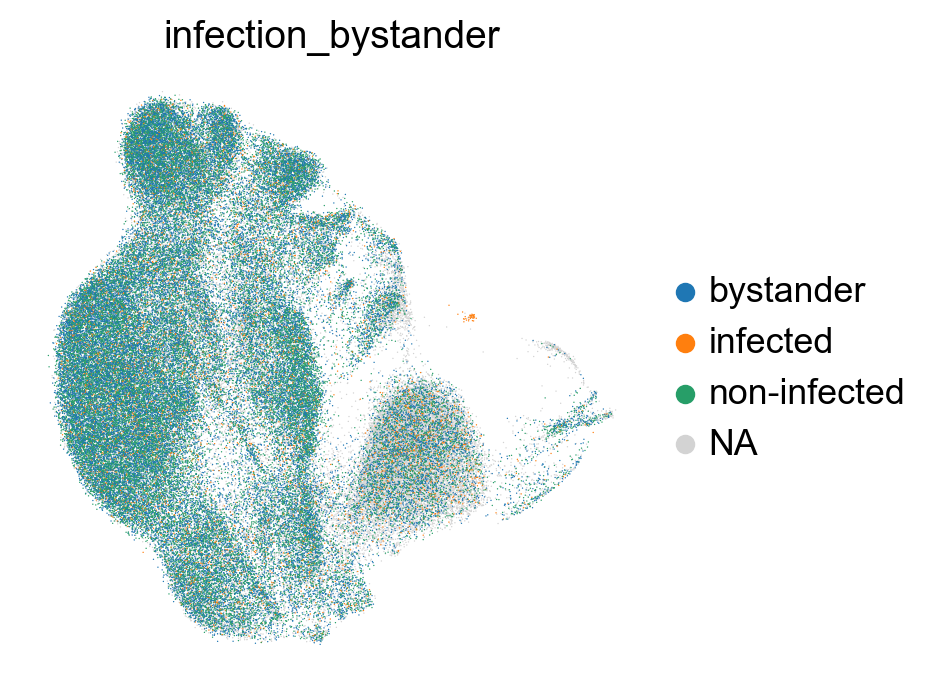

In [46]:
adata.obs.infection_bystander.value_counts()
sc.pl.umap(adata[adata.obs.patient == 'patient_3'], color='infection_bystander')

In [12]:
sc.tl.rank_genes_groups(adata, groupby='infection_bystander')

/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'infection_bystander' as categorical


In [13]:
sc.get.rank_genes_groups_df(adata, group='bystander')

/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,names,scores,logfoldchanges,pvals,pvals_adj
0,ISG15,76.169586,0.748468,0.0,0.0
1,IFIT1,74.683708,0.960064,0.0,0.0
2,IFIT3,72.520081,0.915800,0.0,0.0
3,MX1,71.752899,0.706661,0.0,0.0
4,BST2,71.405762,0.712253,0.0,0.0
...,...,...,...,...,...
18110,LRRC75A,-52.084328,-0.634828,0.0,0.0
18111,EGR1,-60.085648,-0.405098,0.0,0.0
18112,ORF1ab,-60.129593,-25.038054,0.0,0.0
18113,ORF10,-79.083565,-26.119080,0.0,0.0


Plot with diffxpy.

In [14]:
import diffxpy.api as de

/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/patsy/constraint.py:13: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3, and in 3.10 it will stop working
  from collections import Mapping


In [29]:
test_tt = de.test.t_test(
    data=adata[adata.obs.infection_bystander.isin(['bystander', 'non-infected'])],
    grouping="infection_bystander",
    is_logged=True,
)

/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/diffxpy/testing/det.py:1567: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mean_x0 = np.asarray(np.mean(x0, axis=0)).flatten().astype(dtype=np.float)


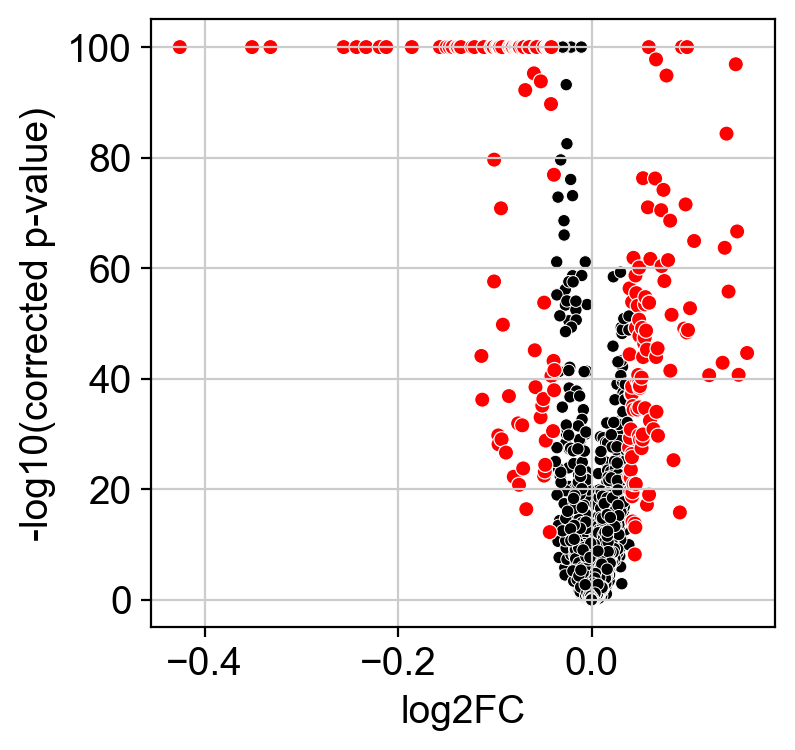

In [30]:
signif_genes = list(test_tt.summary().sort_values('log2fc')['gene'][-100:].values) + list(test_tt.summary().sort_values('log2fc')['gene'][:100].values)
test_tt.plot_volcano(
    corrected_pval=True, min_fc=1.05, alpha=0.05, size=20, log10_p_threshold=-100, log2_fc_threshold=10,
     highlight_ids=signif_genes)

In [31]:
enrich(signif_genes).head()

/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents,intersections,evidences
0,GO:BP,GO:0009607,response to biotic stimulus,1.755964e-43,True,"""Any process that results in a change in state...",1378,199,90,17754,0.452261,0.065312,query_1,[GO:0050896],"[CXCL6, NFKBIA, JUND, GSTP1, TPT1, LITAF, VAMP...","[[IDA, IBA, IEA], [IEA], [IEA], [ISS], [IEP], ..."
1,GO:BP,GO:0051707,response to other organism,6.225133e-43,True,"""Any process that results in a change in state...",1339,199,88,17754,0.442211,0.065721,query_1,"[GO:0043207, GO:0044419]","[CXCL6, NFKBIA, JUND, GSTP1, TPT1, LITAF, VAMP...","[[IDA, IBA, IEA], [IEA], [IEA], [ISS], [IEP], ..."
2,GO:BP,GO:0043207,response to external biotic stimulus,6.225133e-43,True,"""Any process that results in a change in state...",1340,199,88,17754,0.442211,0.065672,query_1,"[GO:0009605, GO:0009607]","[CXCL6, NFKBIA, JUND, GSTP1, TPT1, LITAF, VAMP...","[[IDA, IBA, IEA], [IEA], [IEA], [ISS], [IEP], ..."
3,GO:BP,GO:0044419,biological process involved in interspecies in...,4.838730e-42,True,"""Any process evolved to enable an interaction ...",1498,199,91,17754,0.457286,0.060748,query_1,[GO:0008150],"[CXCL6, NFKBIA, JUND, GSTP1, TPT1, LITAF, VAMP...","[[IDA, IBA, IEA], [IEA], [IEA], [ISS], [IEP], ..."
4,GO:BP,GO:0034097,response to cytokine,2.730040e-36,True,"""Any process that results in a change in state...",1148,199,76,17754,0.381910,0.066202,query_1,[GO:0010033],"[CXCL6, NFKBIA, KRT18, GSTP1, IL32, CIB1, TNFR...","[[IBA], [IDA, TAS, IEA], [IEA], [IC], [TAS], [..."


This kind of enrichment is too coarse and doesn't tell us much.

Taking the expression patterns of the top 100 genes, recluster.

In [32]:
adata.var['viral'] = adatas['patient_3'].var['viral']

/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [33]:
gene_adata = adata[:, signif_genes].copy().T
gene_adata

AnnData object with n_obs × n_vars = 200 × 300353
    obs: 'viral'
    var: 'identifier', 'patient', 'name', 'barcode_round', 'sample', 'viral_counts', 'treatment', 'treatment_virus', 'infected', 'n_counts', 'n_genes', 'percent_mito', 'percent_viral', 'leiden', 'final_bcs', 'batch', 'celltype_coarse', 'cell_type', 'infection_label', 'infection_bystander'
    uns: 'rank_genes_groups'
    varm: 'X_pca', 'X_umap'
    layers: 'counts'

In [34]:
sc.pp.subsample(gene_adata, fraction=.5)

/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [35]:
%%time
sc.tl.pca(gene_adata)
sc.pp.neighbors(gene_adata)
sc.tl.umap(gene_adata)
gene_adata.obs['viral'] = gene_adata.obs['viral'].astype(str)

CPU times: user 2min 19s, sys: 6min 25s, total: 8min 44s
Wall time: 13.2 s


In [36]:
sc.tl.leiden(gene_adata)

/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/home/icb/yuge.ji/miniconda3/envs/r_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'viral' as categorical


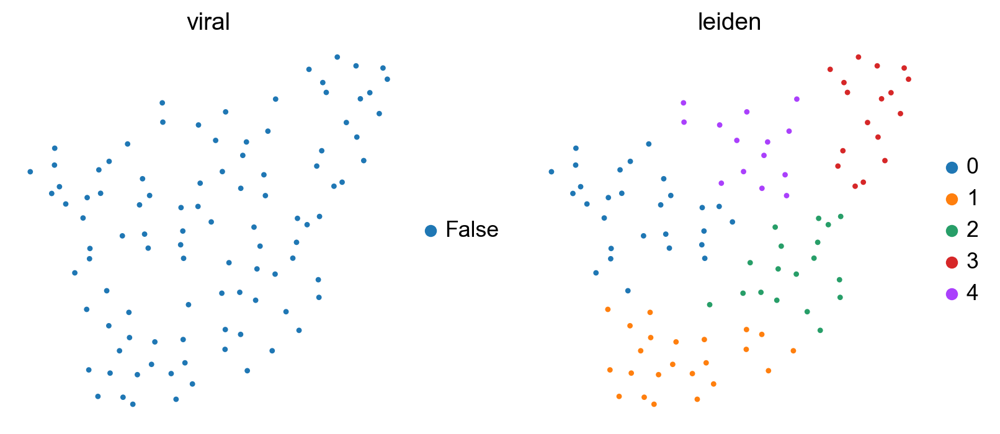

In [37]:
sc.pl.umap(gene_adata, color=['viral', 'leiden'], size=40)

Enrichment analysis for each cluster of genes:

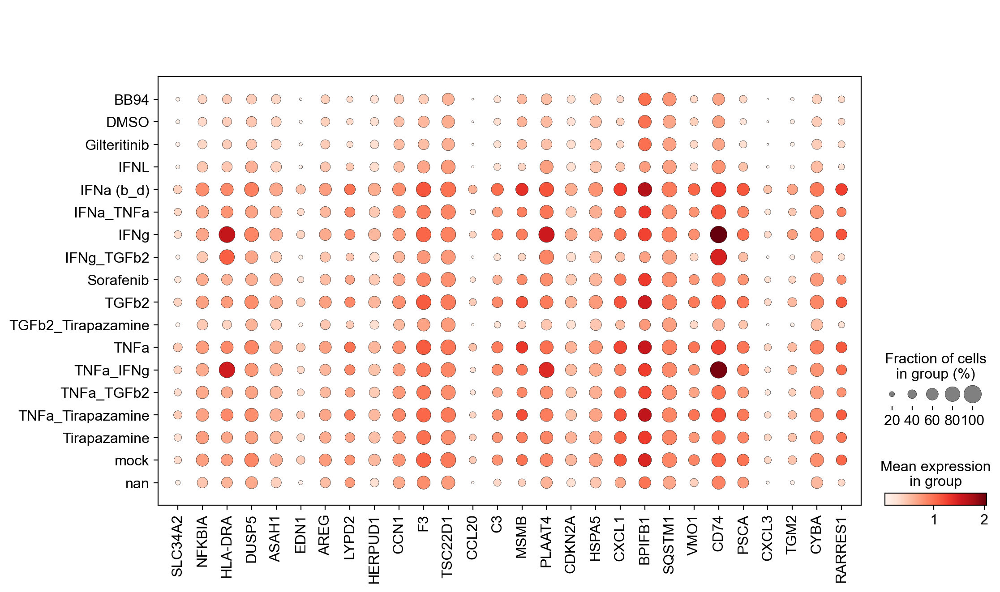

,name,p_value,description,intersection_size,intersections
0,cellular response to cytokine stimulus,0.000050,"""Any process that results in a change in state...",12,"[NFKBIA, HLA-DRA, ASAH1, EDN1, F3, CCL20, HSPA..."
1,response to cytokine,0.000060,"""Any process that results in a change in state...",12,"[NFKBIA, HLA-DRA, ASAH1, EDN1, F3, CCL20, HSPA..."
2,regulation of signal transduction,0.000143,"""Any process that modulates the frequency, rat...",17,"[NFKBIA, DUSP5, EDN1, AREG, HERPUD1, CCN1, F3,..."


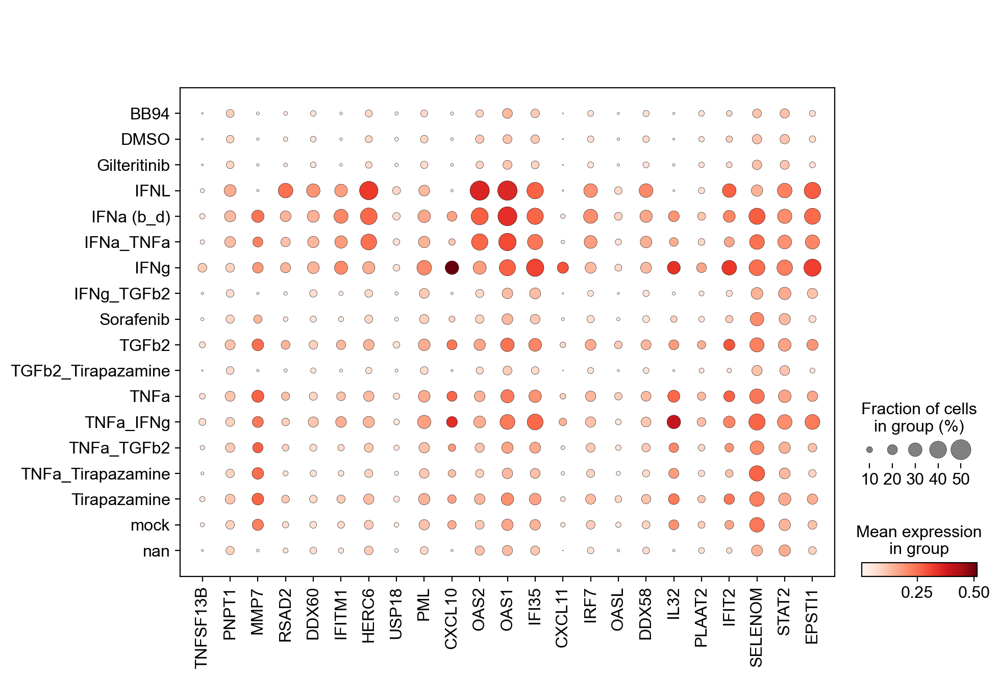

,name,p_value,description,intersection_size,intersections
0,cellular response to type I interferon,3.387352e-15,"""Any process that results in a change in state...",10,"[RSAD2, IFITM1, USP18, OAS2, OAS1, IFI35, IRF7..."
1,type I interferon signaling pathway,3.387352e-15,"""A series of molecular signals initiated by th...",10,"[RSAD2, IFITM1, USP18, OAS2, OAS1, IFI35, IRF7..."
2,response to type I interferon,4.028725e-15,"""Any process that results in a change in state...",10,"[RSAD2, IFITM1, USP18, OAS2, OAS1, IFI35, IRF7..."


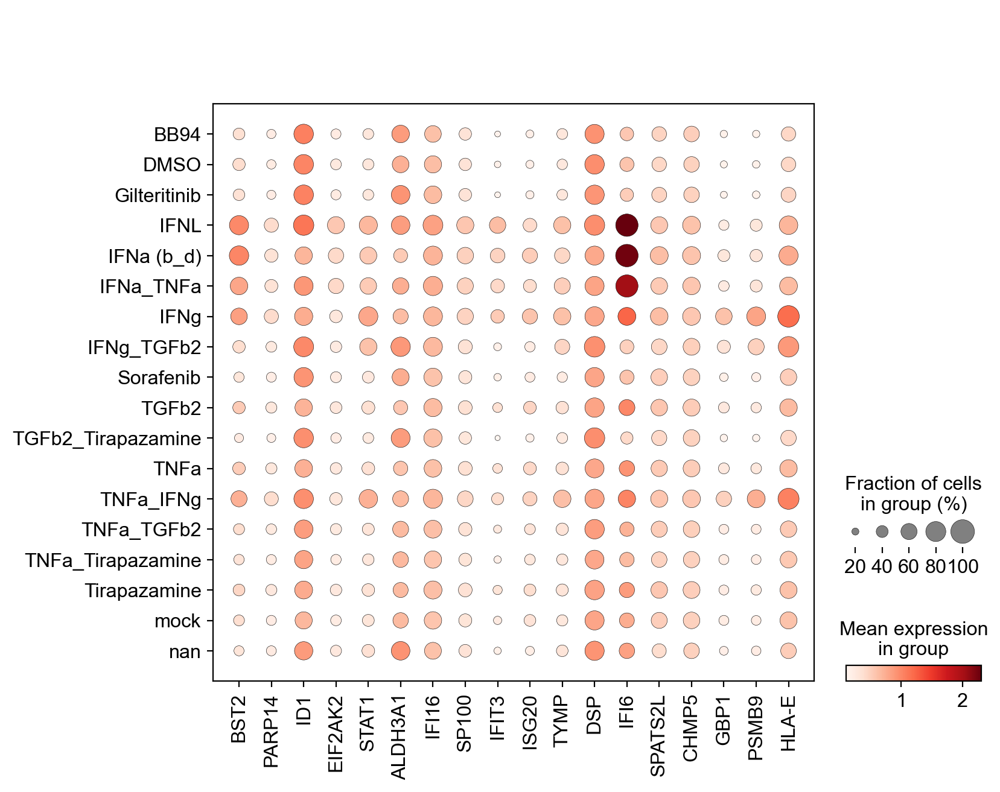

,name,p_value,description,intersection_size,intersections
0,type I interferon signaling pathway,8.299105e-10,"""A series of molecular signals initiated by th...",7,"[BST2, STAT1, SP100, IFIT3, ISG20, IFI6, HLA-E]"
1,innate immune response,8.299105e-10,"""Innate immune responses are defense responses...",12,"[BST2, PARP14, EIF2AK2, STAT1, IFI16, SP100, I..."
2,cellular response to type I interferon,8.299105e-10,"""Any process that results in a change in state...",7,"[BST2, STAT1, SP100, IFIT3, ISG20, IFI6, HLA-E]"


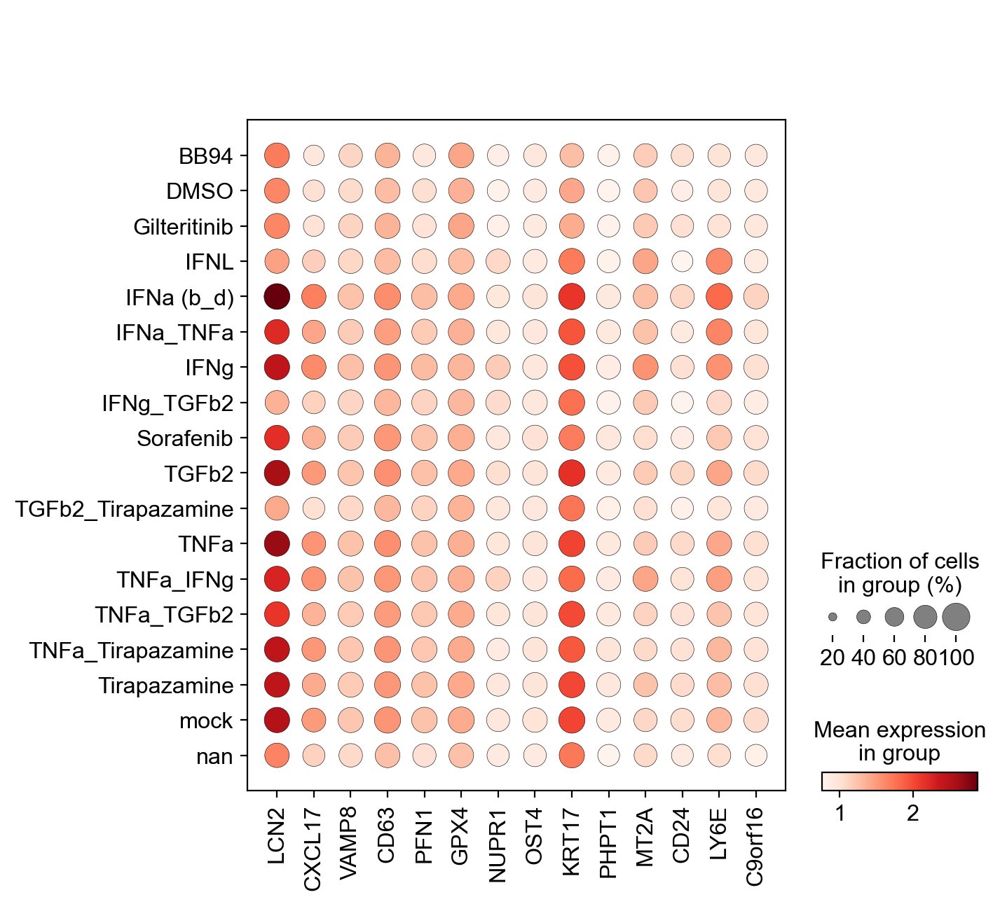

,name,p_value,description,intersection_size,intersections
0,response to toxic substance,0.030522,"""Any process that results in a change in state...",4,"[LCN2, GPX4, NUPR1, MT2A]"


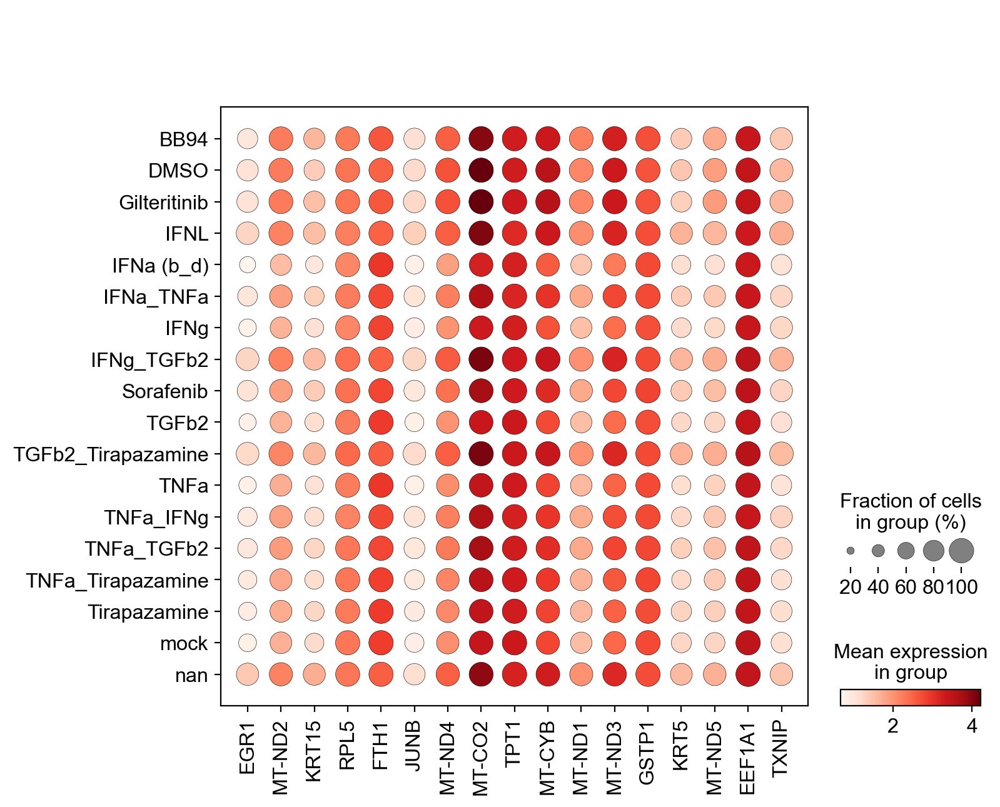

,name,p_value,description,intersection_size,intersections
0,aerobic electron transport chain,8.026180e-10,"""A process in which a series of electron carri...",7,"[MT-ND2, MT-ND4, MT-CO2, MT-CYB, MT-ND1, MT-ND..."
1,ATP synthesis coupled electron transport,8.026180e-10,"""The transfer of electrons through a series of...",7,"[MT-ND2, MT-ND4, MT-CO2, MT-CYB, MT-ND1, MT-ND..."
2,mitochondrial ATP synthesis coupled electron t...,8.026180e-10,"""The transfer of electrons through a series of...",7,"[MT-ND2, MT-ND4, MT-CO2, MT-CYB, MT-ND1, MT-ND..."


In [47]:
for clust in gene_adata.obs.leiden.unique():
    genes = gene_adata[gene_adata.obs.leiden == clust].obs.index
    
    sc.pl.dotplot(adata, var_names=genes, groupby=['treatment'])
    # TODO: plot co-expression by ordering the samples? why doesn't plotting by cell type look like co-expression...?
    
#     test_tt.plot_volcano(
#         corrected_pval=True, min_fc=1.05, alpha=0.05, size=20, log10_p_threshold=-100, log2_fc_threshold=10,
#         highlight_ids=genes)
    
    display(enrich(list(genes))[['name', 'p_value', 'description', 'intersection_size', 'intersections']].head(3))

Score these programs for activity in the infected and bystander groups.

## TRash

Taking only the mock samples, cluster the multicellular programs and see if there are bystander cells. 

Ciliated.

In [10]:
infected_sample = adata[adata.obs.virus_infected == 'infection']
infected_sample = infected_sample[infected_sample.obs.cell_type == 'ciliated']
infected_sample.obs.infected.value_counts()

non-infected    223
infected         21
Name: infected, dtype: int64

In [13]:
infected_sample = infected_sample.T.copy()

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


         Falling back to preprocessing with `sc.pp.pca` and default params.


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


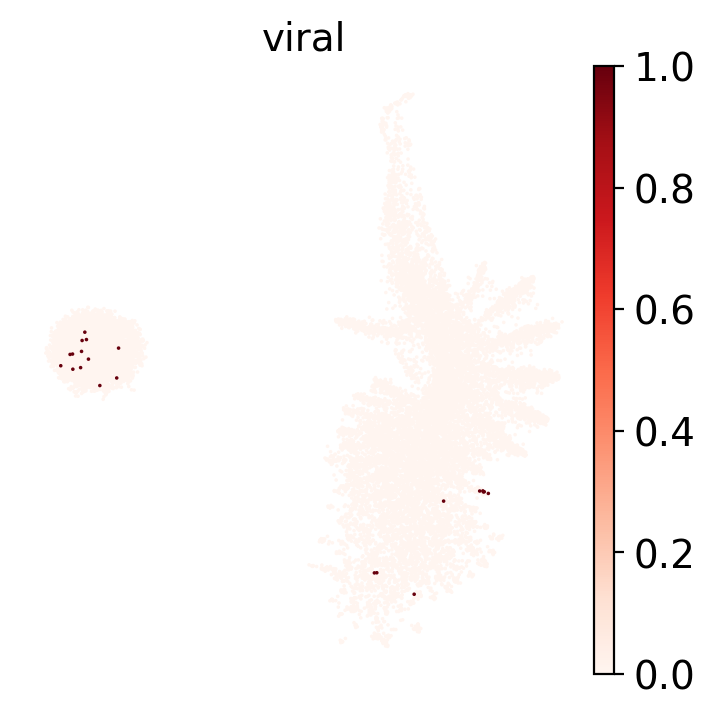

In [14]:
sc.pp.neighbors(infected_sample)
sc.tl.pca(infected_sample)
sc.tl.umap(infected_sample)
sc.pl.umap(infected_sample, color='viral')

In [55]:
sc.tl.rank_genes_groups(infected_sample, 'infected')

Trying to set attribute `.uns` of view, copying.


What would we expect bystander cells to look like?

In [50]:
# upregulated in infected sample
enrichr(infected_sample.uns['rank_genes_groups']['names']['infected'][:50]).head(10)

Enrichr API : Get enrichment results: Job Id: {'shortId': '1ecce502119353e0161795462b9d185d', 'userListId': 39438870}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Ubiquitin mediated proteolysis,0.046080,6.115741,18.820402,"[TRIP12, TRIM37]",0.375935,0,0
1,2,Non-alcoholic fatty liver disease (NAFLD),0.053525,5.613095,16.432935,"[MLXIP, ADIPOR1]",0.375935,0,0
2,3,Protein processing in endoplasmic reticulum,0.064062,5.058027,13.898959,"[DNAJC3, SEC13]",0.375935,0,0
3,4,RNA transport,0.064062,5.058027,13.898959,"[SEC13, EIF4G3]",0.375935,0,0
4,5,Tight junction,0.067489,4.906250,13.226257,"[MYH14, YBX3]",0.375935,0,0
5,6,Circadian rhythm,0.074716,13.551020,35.152090,[CSNK1D],0.375935,0,0
6,7,Tyrosine metabolism,0.086244,11.612245,28.456712,[COMT],0.375935,0,0
7,8,Ferroptosis,0.095364,10.419152,24.485561,[SLC11A2],0.375935,0,0
8,9,Hedgehog signaling pathway,0.111111,8.830524,19.402687,[CSNK1D],0.375935,0,0
9,10,Amino sugar and nucleotide sugar metabolism,0.113338,8.642206,18.817372,[CYB5R4],0.375935,0,0


In [51]:
# downregulated in infected sample
enrichr(infected_sample.uns['rank_genes_groups']['names']['non-infected'][:70]).head(10)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Enrichr API : Get enrichment results: Job Id: {'shortId': 'e4745f855d9deef344190c2159667af9', 'userListId': 39438872}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,D-Glutamine and D-glutamate metabolism,0.017380,72.195652,292.570220,[GLS],0.348469,0,0
1,2,RNA transport,0.020169,5.463792,21.328371,"[NUP85, SUMO3, THOC6]",0.348469,0,0
2,3,Phosphonate and phosphinate metabolism,0.020820,57.753623,223.614161,[PCYT2],0.348469,0,0
3,4,Bile secretion,0.026368,8.344538,30.337571,"[NCEH1, SLC51A]",0.348469,0,0
4,5,Synaptic vesicle cycle,0.030567,7.683437,26.798432,"[SLC6A9, ATP6V0A2]",0.348469,0,0
5,6,mRNA surveillance pathway,0.040496,6.556841,21.024847,"[PPP2R3C, CSTF1]",0.384712,0,0
6,7,Arginine biosynthesis,0.071018,14.427536,38.158337,[GLS],0.468327,0,0
7,8,Proximal tubule bicarbonate reclamation,0.077516,13.114625,33.537631,[GLS],0.468327,0,0
8,9,Ubiquitin mediated proteolysis,0.083243,4.312636,10.721180,"[CBL, ANAPC1]",0.468327,0,0
9,10,Glycosylphosphatidylinositol (GPI)-anchor bios...,0.083970,12.020531,29.778447,[PIGV],0.468327,0,0


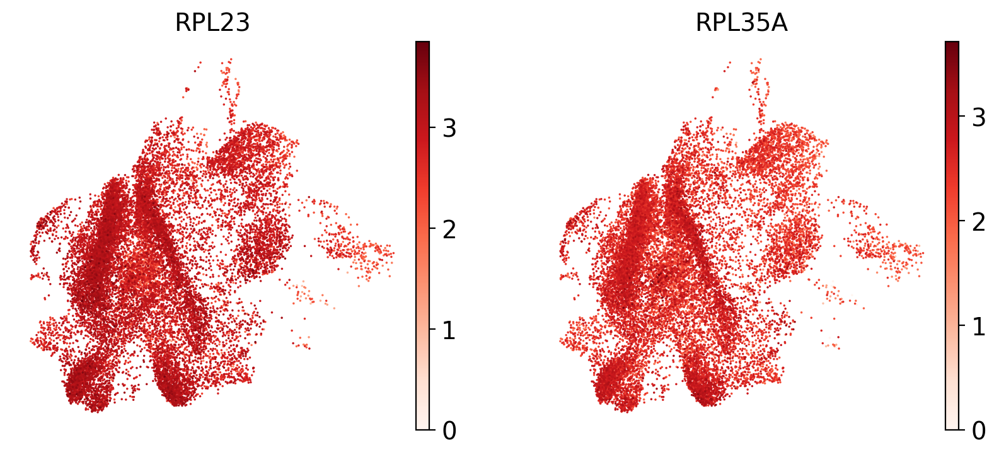

In [43]:
sc.pl.umap(adata, color=['RPL23', 'RPL35A'])

In [57]:
infected_sample.uns['rank_genes_groups']['names']['non-infected']

array(['PCYT2', 'FAM3B', 'PPP2R3C', ..., 'FAM120A', 'PTBP3', 'TSPAN3'],
      dtype=object)

In [56]:
infected_sample.uns['rank_genes_groups']['scores']['non-infected']

array([ 8.692404 ,  7.892469 ,  7.7792788, ..., -3.7869592, -3.8703501,
       -4.2811713], dtype=float32)

## Co-correlation of genes

In [68]:
import math
adata = adatas['patient_3'].copy()
adata.obs['infected'] = ['sars-cov-2' in s if not pd.isnull(s) else math.nan for s in adata.obs.treatment_virus.values]

In [69]:
# subset to a single condition?
adata = adata[(adata.obs.treatment == 'mock') & (adata.obs.cell_type == 'basal')]

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [70]:
adata = adata.copy().T
adata

AnnData object with n_obs × n_vars = 18115 × 7933
    obs: 'gene_ids', 'feature_types', 'genome', 'viral', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    var: 'identifier', 'patient', 'name', 'barcode_round', 'sample', 'viral_counts', 'treatment', 'treatment_virus', 'infected', 'n_counts', 'n_genes', 'percent_mito', 'percent_viral', 'leiden', 'final_bcs', 'batch', 'celltype_coarse', 'cell_type', 'leiden_0', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4', 'leiden_5', 'leiden_6', 'leiden_7', 'leiden_8', 'leiden_9', 'leiden_10', 'leiden_11', 'leiden_12', 'leiden_13', 'leiden_14', 'leiden_15', 'leiden_16', 'leiden_17', 'leiden_18', 'leiden_19', 'leiden_20', 'leiden_21', 'leiden_22', 'leiden_23', 'leiden_24', 'leiden_25', 'leiden_26', 'leiden_27', 'leiden_28', 'leiden_29', 'leiden_30'
    uns: 'cell_type_colors', 'celltype_coarse_colors', 'hvg', 'identifier_colors', 'leiden', 'leiden_colors', 'neighbor

In [71]:
%%time
sc.pp.pca(adata)
sc.pp.neighbors(adata)  # takes a while
sc.tl.umap(adata)

CPU times: user 4min 20s, sys: 4.98 s, total: 4min 25s
Wall time: 34 s


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'infected' as categorical
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scanpy/plotting/_tools/__init__.py:1156: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("YlOrRd"))
  color_map.set_over('black')
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/scanpy/plotting/_tools/scatterplots.py:400: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor relea

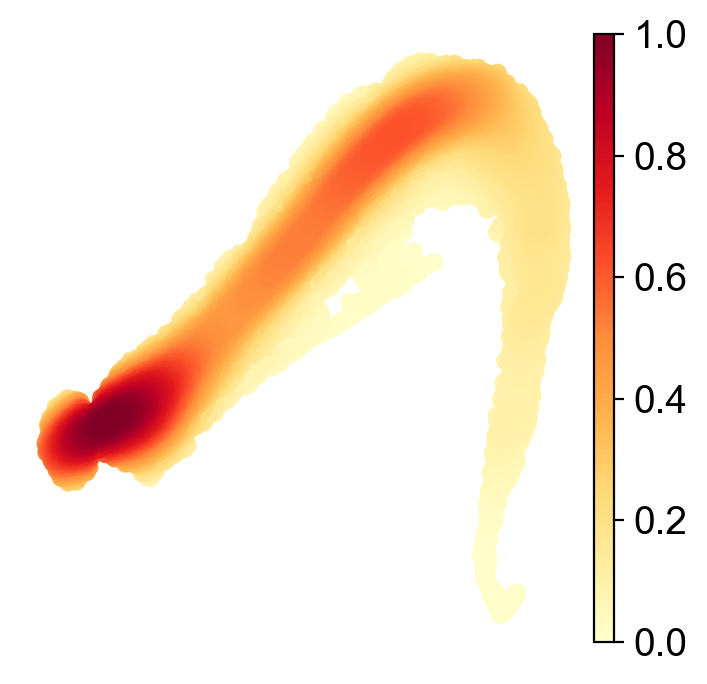

In [73]:
sc.tl.embedding_density(adata)
sc.pl.embedding_density(adata)

In [74]:
adata.obs['means_for_group'] = adata.X.mean(axis=1)

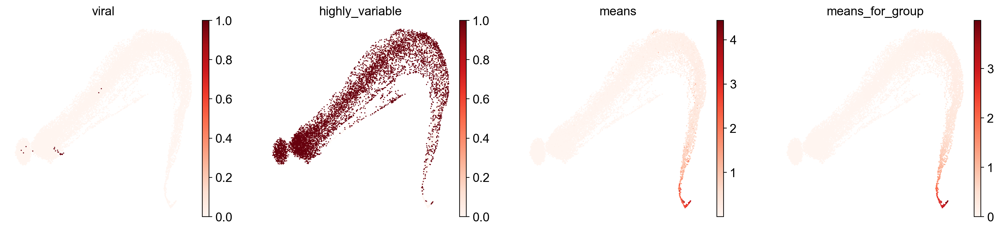

In [75]:
sc.pl.umap(adata, color=['viral', 'highly_variable', 'means', 'means_for_group'])

In [79]:
sc.tl.leiden(adata, resolution=6)

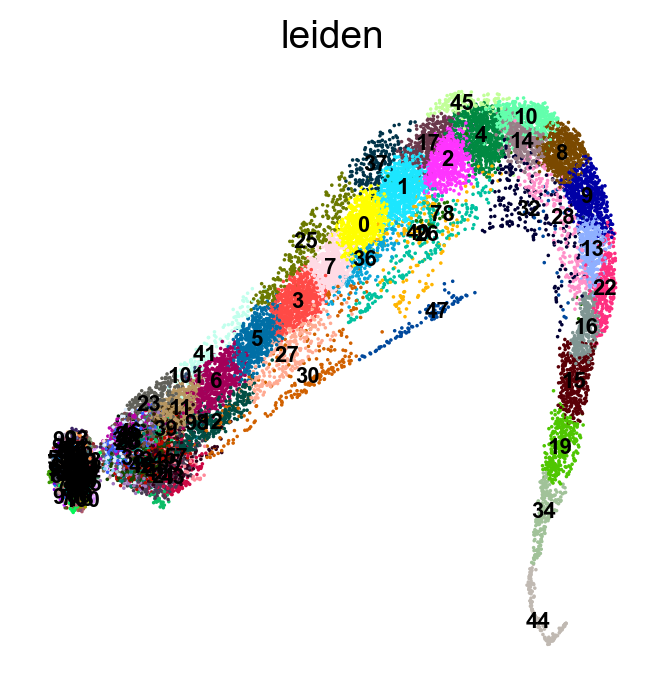

In [80]:
sc.pl.umap(adata, color='leiden', legend_loc='on data', legend_fontsize=8)

In [82]:
# plot mean expression of gene sets on UMAP
df = adata.to_df()
df['leiden'] = adata.obs['leiden']
means = df.groupby('leiden').mean().T.add_prefix('leiden_')

adata_orig = adatas['patient_3']
for c in means.columns:
    adata_orig.obs[c] = means[c].
    
sc.pl.umap(adata_orig, color=means.columns, vmin=0, color_map=gray_red)

In [83]:
for group in adata.obs.leiden.unique():
    genes = adata[adata.obs.leiden == group].obs_names
    print(group)
    display(enrichr(genes))

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


23
Enrichr API : Get enrichment results: Job Id: {'shortId': '261942b70b483caa5579c8a81f0f8c47', 'userListId': 40435134}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Butanoate metabolism,0.005837,9.062529,46.613650,"[ACSM6, OXCT2, HMGCS2]",0.542650,0,0
1,2,Synthesis and degradation of ketone bodies,0.007284,18.824427,92.655508,"[OXCT2, HMGCS2]",0.542650,0,0
2,3,Complement and coagulation cascades,0.020611,4.033026,15.655997,"[SERPINA1, SERPIND1, ITGB2, C4BPB]",0.719593,0,0
3,4,Pantothenate and CoA biosynthesis,0.025604,8.854513,32.451898,"[VNN1, VNN3]",0.719593,0,0
4,5,Malaria,0.026825,4.920040,17.802693,"[GYPC, ITGB2, TLR4]",0.719593,0,0
...,...,...,...,...,...,...,...,...,...
144,145,Huntington disease,0.924000,0.387041,0.030593,[DNAH2],0.949489,0,0
145,146,Proteoglycans in cancer,0.931736,0.371407,0.026260,[TLR4],0.950882,0,0
146,147,cAMP signaling pathway,0.941109,0.351846,0.021356,[CACNA1F],0.953913,0,0
147,148,Endocytosis,0.961696,0.305012,0.011913,[IL2RG],0.968194,0,0


4


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': 'aef7f32c5f374be8a8639880bd4dffed', 'userListId': 40435135}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,"Valine, leucine and isoleucine degradation",0.000026,6.756041,7.143172e+01,"[HMGCL, ALDH6A1, IVD, BCKDHB, MCCC1, PCCB, MMU...",0.006425,0,0
1,2,Insulin resistance,0.000261,3.665396,3.024611e+01,"[IKBKB, MLXIP, CREB3, CPT1A, RPS6KB1, AKT2, NR...",0.024393,0,0
2,3,RNA degradation,0.000292,4.242765,3.453729e+01,"[EXOSC5, CNOT6, EXOSC10, PAN3, TOB2, CNOT8, DC...",0.024393,0,0
3,4,Propanoate metabolism,0.000586,6.729956,5.009045e+01,"[ALDH6A1, BCKDHB, PCCB, MMUT, ACACA, ACAT1]",0.036745,0,0
4,5,Ubiquitin mediated proteolysis,0.002171,2.810780,1.723751e+01,"[UBE2W, COP1, CDC34, UBE3C, HERC1, ANAPC7, SMU...",0.095745,0,0
...,...,...,...,...,...,...,...,...,...
246,247,Retrograde endocannabinoid signaling,0.993566,0.195667,1.263003e-03,[ITPR3],0.999992,0,0
247,248,Tight junction,0.996970,0.170001,5.159357e-04,[VASP],0.999992,0,0
248,249,Cytokine-cytokine receptor interaction,0.999514,0.195812,9.516008e-05,"[IL4R, FAS]",0.999992,0,0
249,250,Neuroactive ligand-receptor interaction,0.999987,0.084505,1.080883e-06,[NPW],0.999992,0,0


5


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '59714f56740c0874ca862215a47fced6', 'userListId': 40435136}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Herpes simplex virus 1 infection,4.313173e-18,4.474769,1.789230e+02,"[ZNF253, ZNF175, ZNF250, ZNF490, ZNF45, ZFP82,...",9.316454e-16,0,0
1,2,Fatty acid elongation,8.707329e-03,5.539188,2.627564e+01,"[ACAA2, ACOT2, PPT2, ACOT4]",8.918017e-01,0,0
2,3,Primary bile acid biosynthesis,1.407826e-02,6.817030,2.906184e+01,"[CYP39A1, HSD3B7, AMACR]",8.918017e-01,0,0
3,4,Retinol metabolism,1.651485e-02,3.136991,1.287263e+01,"[CYP2C9, RDH5, UGT2A1, CYP3A5, UGT1A7, UGT1A6]",8.918017e-01,0,0
4,5,Mannose type O-glycan biosynthesis,3.203633e-02,4.770443,1.641455e+01,"[POMT2, LARGE1, FUT4]",9.999954e-01,0,0
...,...,...,...,...,...,...,...,...,...
211,212,Calcium signaling pathway,9.971761e-01,0.168051,4.752240e-04,[PLCB1],9.999954e-01,0,0
212,213,Viral carcinogenesis,9.981213e-01,0.157021,2.952746e-04,[TRAF5],9.999954e-01,0,0
213,214,Neuroactive ligand-receptor interaction,9.982310e-01,0.280171,4.960662e-04,"[GABRB3, P2RY11, TRPV1]",9.999954e-01,0,0
214,215,MicroRNAs in cancer,9.990884e-01,0.210752,1.921992e-04,"[RPTOR, BMF]",9.999954e-01,0,0


45


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '27df39776b3d74016285a25b86e9b04a', 'userListId': 40435137}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Amino sugar and nucleotide sugar metabolism,0.003831,10.325000,57.455881,"[GFPT1, PGM2, GNE]",0.440358,0,0
1,2,Insulin resistance,0.005574,5.985766,31.063824,"[PRKAA2, CREB3L2, GFPT1, SLC27A2]",0.440358,0,0
2,3,Non-small cell lung cancer,0.009306,7.368304,34.461980,"[RASSF5, TGFA, SOS2]",0.477645,0,0
3,4,Estrogen signaling pathway,0.012643,4.673732,20.427306,"[KRT16, CREB3L2, TGFA, SOS2]",0.477645,0,0
4,5,Pentose and glucuronate interconversions,0.020831,9.610950,37.206900,"[SORD, CRYL1]",0.477645,0,0
...,...,...,...,...,...,...,...,...,...
153,154,Proteoglycans in cancer,0.734873,0.756500,0.233045,[SOS2],0.753961,0,0
154,155,Rap1 signaling pathway,0.743530,0.737861,0.218662,[RASSF5],0.757921,0,0
155,156,cAMP signaling pathway,0.753548,0.716661,0.202788,[CREB3L2],0.761621,0,0
156,157,Regulation of actin cytoskeleton,0.756801,0.709859,0.197806,[SOS2],0.761621,0,0


6


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '30b132cfe629d264b875dabdd5037721', 'userListId': 40435138}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Herpes simplex virus 1 infection,1.050770e-12,3.664652,101.076594,"[ZNF155, ZNF154, ZNF671, PIK3CD, PIK3R2, C5, Z...",2.332710e-10,0,0
1,2,Selenocompound metabolism,1.377163e-02,6.875237,29.461381,"[CTH, KYAT1, SCLY]",8.433480e-01,0,0
2,3,Rheumatoid arthritis,2.070646e-02,2.681806,10.398191,"[CSF1, ANGPT1, IL23A, TGFB3, CTSK, ATP6V0A4, A...",8.433480e-01,0,0
3,4,Arginine biosynthesis,2.463202e-02,5.346302,19.801143,"[ABHD14A-ACY1, ACY1, CPS1]",8.433480e-01,0,0
4,5,Bacterial invasion of epithelial cells,2.479838e-02,2.837183,10.489001,"[DNM3, SHC4, PIK3CD, PIK3R2, ITGA5, DNM1]",8.433480e-01,0,0
...,...,...,...,...,...,...,...,...,...
217,218,Retrograde endocannabinoid signaling,9.897273e-01,0.216048,0.002231,[GNG7],9.999815e-01,0,0
218,219,Tight junction,9.948127e-01,0.187709,0.000976,[CGNL1],9.999815e-01,0,0
219,220,Endocytosis,9.954790e-01,0.261608,0.001185,"[DNM3, DNM1]",9.999815e-01,0,0
220,221,Thermogenesis,9.992211e-01,0.137487,0.000107,[COX6B2],9.999815e-01,0,0


34


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '22f75495b32fd6b86f11b7bf592af90a', 'userListId': 40435139}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Oxidative phosphorylation,1.944261e-35,37.150401,2969.267936,"[COX7B, NDUFB7, NDUFB10, UQCRB, NDUFB11, NDUFB...",3.985735e-33,0,0
1,2,Parkinson disease,6.534272e-33,32.536862,2411.249832,"[COX7B, NDUFB7, NDUFB10, UQCRB, NDUFB11, NDUFB...",6.697629e-31,0,0
2,3,Huntington disease,6.791526e-30,23.234546,1560.475723,"[COX7B, NDUFB7, NDUFB10, UQCRB, NDUFB11, NDUFB...",4.640876e-28,0,0
3,4,Alzheimer disease,7.899535e-29,24.604506,1592.112382,"[COX7B, NDUFB7, NDUFB10, UQCRB, NDUFB11, NDUFB...",4.048511e-27,0,0
4,5,Thermogenesis,2.500168e-27,18.761426,1149.201882,"[COX7B, NDUFB7, NDUFB10, UQCRB, NDUFB11, NDUFB...",1.025069e-25,0,0
...,...,...,...,...,...,...,...,...,...
200,201,Hippo signaling pathway,8.010112e-01,0.620745,0.137731,[YWHAZ],8.150203e-01,0,0
201,202,MicroRNAs in cancer,8.030932e-01,0.663300,0.145451,"[HNRNPK, SOX4]",8.150203e-01,0,0
202,203,Olfactory transduction,9.387141e-01,0.442388,0.027978,"[CALM1, CALM2]",9.479625e-01,0,0
203,204,Neuroactive ligand-receptor interaction,9.674848e-01,0.290220,0.009593,[TSPO],9.722274e-01,0,0


78


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '75af169c5f3294a9cb61236e5e2be554', 'userListId': 40435140}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Measles,9.420100e-14,53.429418,1602.527003,"[IFIH1, OAS1, STAT1, DDX58, OAS2, OAS3, MX1, I...",5.275256e-12,0,0
1,2,Hepatitis C,3.055251e-13,47.124851,1357.984795,"[OAS1, STAT1, DDX58, OAS2, OAS3, MX1, IRF7, EI...",8.554704e-12,0,0
2,3,Influenza A,8.217915e-13,42.407368,1180.082106,"[IFIH1, OAS1, STAT1, DDX58, OAS2, OAS3, MX1, I...",1.534011e-11,0,0
3,4,Epstein-Barr virus infection,4.141387e-12,35.692363,935.496498,"[OAS1, STAT1, DDX58, OAS2, OAS3, IRF7, EIF2AK2...",5.797942e-11,0,0
4,5,Herpes simplex virus 1 infection,1.606871e-09,15.910306,322.167422,"[BST2, IFIH1, OAS1, STAT1, DDX58, OAS2, OAS3, ...",1.799695e-08,0,0
5,6,NOD-like receptor signaling pathway,1.167716e-06,20.918605,285.757776,"[OAS1, STAT1, OAS2, OAS3, IRF7, IRF9]",1.089868e-05,0,0
6,7,RIG-I-like receptor signaling pathway,1.031602e-05,34.450216,395.550932,"[IFIH1, DDX58, IRF7, ISG15]",8.252815e-05,0,0
7,8,Kaposi sarcoma-associated herpesvirus infection,2.936485e-05,16.070848,167.710748,"[STAT1, IRF7, EIF2AK2, HLA-F, IRF9]",2.055539e-04,0,0
8,9,Human papillomavirus infection,3.974625e-05,11.019641,111.661967,"[STAT1, MX1, EIF2AK2, ISG15, HLA-F, IRF9]",2.473100e-04,0,0
9,10,Hepatitis B,2.800033e-04,14.233243,116.438023,"[IFIH1, STAT1, DDX58, IRF7]",1.568019e-03,0,0


41


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '25f5ef2e1b2469e5c1e27c214018c321', 'userListId': 40435141}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Metabolism of xenobiotics by cytochrome P450,0.000258,9.683705,79.995155,"[CYP2B6, CYP2A13, ALDH3B1, CYP2E1, UGT2B7]",0.041094,0,0
1,2,Salivary secretion,0.000639,7.854531,57.770233,"[CHRM3, BST1, GUCY1A1, ADCY2, LYZ]",0.049866,0,0
2,3,Pancreatic secretion,0.000941,7.175966,50.007256,"[CHRM3, BST1, ATP2A3, ADCY2, CEL]",0.049866,0,0
3,4,Nicotinate and nicotinamide metabolism,0.001532,14.681481,95.157224,"[BST1, NT5E, ENPP3]",0.060881,0,0
4,5,Purine metabolism,0.003157,5.373529,30.940734,"[GUCY1A1, NT5E, ENPP4, ADCY2, ENPP3]",0.096122,0,0
...,...,...,...,...,...,...,...,...,...
154,155,Focal adhesion,0.784726,0.652877,0.158271,[SHC2],0.803194,0,0
155,156,Proteoglycans in cancer,0.788040,0.646283,0.153949,[ERBB4],0.803194,0,0
156,157,Regulation of actin cytoskeleton,0.808379,0.606437,0.129004,[CHRM3],0.818677,0,0
157,158,Thermogenesis,0.832078,0.561127,0.103151,[ADCY2],0.837344,0,0


0


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': 'c6263d6cb047d421daabb3d20e6b791c', 'userListId': 40435142}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Inositol phosphate metabolism,0.000008,5.088414,5.969646e+01,"[PI4K2B, MTMR1, IPMK, INPPL1, OCRL, MTMR4, MTM...",0.001944,0,0
1,2,Phosphatidylinositol signaling system,0.000047,3.932559,3.920149e+01,"[PI4K2B, MTMR1, DGKE, IPMK, INPPL1, OCRL, MTMR...",0.005670,0,0
2,3,Glycerophospholipid metabolism,0.001949,3.042370,1.898629e+01,"[PGS1, AGPAT5, PTDSS2, DGKE, PCYT2, GPAT4, DGK...",0.118026,0,0
3,4,Herpes simplex virus 1 infection,0.001951,1.782421,1.112140e+01,"[ZNF891, SRC, ZNF44, ZNF3, ZNF708, CASP8, ZNF8...",0.118026,0,0
4,5,Glycosaminoglycan biosynthesis,0.005442,3.609181,1.881679e+01,"[B4GALT3, NDST1, EXTL2, CHSY1, CHPF2, CHST15, ...",0.263398,0,0
...,...,...,...,...,...,...,...,...,...
237,238,Ribosome,0.998306,0.154027,2.611683e-04,[MRPS17],0.999996,0,0
238,239,MicroRNAs in cancer,0.998358,0.316234,5.196032e-04,"[ABL1, E2F3, PTGS2, SIRT1]",0.999996,0,0
239,240,Neuroactive ligand-receptor interaction,0.999550,0.278731,1.253389e-04,"[F2R, LPAR1, LPAR2, LPAR3]",0.999996,0,0
240,241,Cytokine-cytokine receptor interaction,0.999935,0.159373,1.039246e-05,"[BMP3, CCL28]",0.999996,0,0


11


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '8c01da33a3db94e28a8d83bdb19eb5e8', 'userListId': 40435143}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Tyrosine metabolism,0.006316,5.961585,30.193568,"[ADH4, AOC2, ADH1A, ADH6]",0.999428,0,0
1,2,Morphine addiction,0.011558,3.373875,15.048779,"[GRK5, PDE1A, GABRA3, ADCY4, PDE8B, ADCY7]",0.999428,0,0
2,3,Oxytocin signaling pathway,0.040276,2.290061,7.355654,"[CACNB2, CACNA2D1, CACNA2D3, ADCY4, OXT, CALML...",0.999428,0,0
3,4,Dilated cardiomyopathy (DCM),0.040629,2.771934,8.879251,"[CACNB2, CACNA2D1, CACNA2D3, ADCY4, ADCY7]",0.999428,0,0
4,5,Oocyte meiosis,0.045752,2.405709,7.420475,"[STAG3, SPDYE16, ADCY4, SPDYE3, CALML4, ADCY7]",0.999428,0,0
...,...,...,...,...,...,...,...,...,...
191,192,MicroRNAs in cancer,0.986401,0.315272,0.004317,"[SLC45A3, ZEB1]",0.999428,0,0
192,193,Human papillomavirus infection,0.992320,0.285017,0.002197,"[DLG2, FZD4]",0.999428,0,0
193,194,Endocytosis,0.994113,0.192738,0.001138,[GRK5],0.999428,0,0
194,195,Olfactory transduction,0.995290,0.316881,0.001496,"[PDE1A, CALML4, OR13A1]",0.999428,0,0


7


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '2caae7f9bc21a5d423ab5e69e022b841', 'userListId': 40435144}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Herpes simplex virus 1 infection,0.000181,2.208524,19.036561,"[ZNF133, ZNF331, ZNF350, ZNF26, ZNF568, ZNF567...",0.036107,0,0
1,2,"Alanine, aspartate and glutamate metabolism",0.002890,5.754152,33.640998,"[ADSL, PPAT, GPT2, ASNS, RIMKLB]",0.289032,0,0
2,3,N-Glycan biosynthesis,0.013345,3.833136,16.546043,"[MAN2A2, ALG12, DOLK, ALG11, ALG10B]",0.737678,0,0
3,4,Glycosaminoglycan biosynthesis,0.016875,3.593009,14.666364,"[CHST7, UST, XYLT2, CHST14, EXTL3]",0.737678,0,0
4,5,Inositol phosphate metabolism,0.018442,3.045769,12.162145,"[INPP5B, MTMR2, INPP5D, ITPK1, PIP4K2A, PI4K2A]",0.737678,0,0
...,...,...,...,...,...,...,...,...,...
195,196,Alcoholism,0.994483,0.190043,0.001051,[HDAC10],0.999388,0,0
196,197,Rap1 signaling pathway,0.997406,0.165716,0.000430,[RAPGEF5],0.999388,0,0
197,198,PI3K-Akt signaling pathway,0.997696,0.289174,0.000667,"[CHUK, THEM4, JAK2]",0.999388,0,0
198,199,MicroRNAs in cancer,0.998296,0.228074,0.000389,"[SOCS1, BAK1]",0.999388,0,0


29


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '5702c11fd63cacf6e52acb17d0bcddbe', 'userListId': 40435145}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,ECM-receptor interaction,0.017064,4.276836,17.409994,"[TNXB, SV2C, CHAD, COL6A6]",0.951718,0,0
1,2,Cysteine and methionine metabolism,0.018775,5.672037,22.547623,"[SDS, TAT, BCAT1]",0.951718,0,0
2,3,Cell adhesion molecules (CAMs),0.030772,2.981763,10.379953,"[NLGN1, CD8A, ICAM2, PECAM1, ITGAL]",0.951718,0,0
3,4,Phototransduction,0.044179,6.378151,19.896689,"[GNAT2, GUCA1B]",0.951718,0,0
4,5,Mucin type O-glycan biosynthesis,0.053098,5.717473,16.784346,"[GALNT4, GALNT16]",0.951718,0,0
...,...,...,...,...,...,...,...,...,...
109,110,Thermogenesis,0.939493,0.355285,0.022175,[BMP8B],0.973656,0,0
110,111,Endocytosis,0.948379,0.336054,0.017811,[PSD2],0.974011,0,0
111,112,MAPK signaling pathway,0.972345,0.277033,0.007769,[FGF20],0.989708,0,0
112,113,Pathways in cancer,0.988378,0.306086,0.003578,"[IL23R, FGF20]",0.997125,0,0


13


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '4a7f076665598bc025e01bd429dbd5ee', 'userListId': 40435146}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Ribosome,0.000006,5.069428,61.306345,"[MRPL18, MRPS11, MRPS12, MRPS18A, MRPL17, MRPL...",0.001315,0,0
1,2,RNA transport,0.000013,4.666335,52.597360,"[POP5, ALYREF, PABPC4, EIF4A3, THOC3, RPP25L, ...",0.001496,0,0
2,3,mRNA surveillance pathway,0.000047,5.943247,59.165414,"[PPP2CA, PPP1CC, PPP2R1A, PABPC4, ALYREF, EIF4...",0.003720,0,0
3,4,Proteasome,0.000170,8.280220,71.846449,"[PSMD11, PSMC6, PSMC3, PSMC4, PSMD2, PSMC1]",0.010016,0,0
4,5,Human T-cell leukemia virus 1 infection,0.000819,3.145170,22.353302,"[PPP3CA, SMAD3, CDK4, CDC26, VDAC3, BAX, ANAPC...",0.038502,0,0
...,...,...,...,...,...,...,...,...,...
230,231,Leukocyte transendothelial migration,0.877209,0.476550,0.062433,[GNAI3],0.892399,0,0
231,232,Proteoglycans in cancer,0.888979,0.530670,0.062450,"[PPP1CC, HRAS]",0.900474,0,0
232,233,MicroRNAs in cancer,0.917117,0.533931,0.046196,"[NOTCH1, HRAS, NFKB1]",0.924989,0,0
233,234,JAK-STAT signaling pathway,0.952040,0.327711,0.016106,[HRAS],0.956109,0,0


26


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '6ff7e3787fb111fff2d27f0593b9c559', 'userListId': 40435147}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Hippo signaling pathway,0.000930,4.262288,29.751638,"[TGFB2, SERPINE1, LEF1, SNAI2, PARD6G, AJUBA, ...",0.152999,0,0
1,2,Focal adhesion,0.003649,3.385228,19.002328,"[LAMA3, RAC2, COL4A6, BCL2, PDGFA, LAMB1, MYL9...",0.152999,0,0
2,3,Neurotrophin signaling pathway,0.003850,4.273248,23.757542,"[NTF4, NGFR, IRS1, RPS6KA1, BCL2, TP73]",0.152999,0,0
3,4,MAPK signaling pathway,0.004134,2.845760,15.619088,"[NTF4, NGFR, TGFB2, CACNB4, RPS6KA1, RAC2, PDG...",0.152999,0,0
4,5,Colorectal cancer,0.004488,4.955656,26.791813,"[TGFB2, LEF1, RAC2, BCL2, GADD45G]",0.152999,0,0
...,...,...,...,...,...,...,...,...,...
198,199,Kaposi sarcoma-associated herpesvirus infection,0.904688,0.424726,0.042543,[GNB5],0.922872,0,0
199,200,Neuroactive ligand-receptor interaction,0.926499,0.465966,0.035573,"[HRH1, LTB4R]",0.940396,0,0
200,201,Human T-cell leukemia virus 1 infection,0.937335,0.359825,0.023286,[TGFB2],0.946661,0,0
201,202,Herpes simplex virus 1 infection,0.985971,0.316985,0.004478,"[ZNF430, BCL2]",0.990852,0,0


8


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': 'f1eefe65f6bfcecd77a67cc27c7dd7a6', 'userListId': 40435148}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Spliceosome,0.000095,3.823250,3.542643e+01,"[SF3B4, TCERG1, SF3A1, PRPF38A, NCBP2, PLRG1, ...",0.022700,0,0
1,2,SNARE interactions in vesicular transport,0.000311,7.564675,6.108139e+01,"[STX16, STX8, STX6, USE1, STX10, VAMP3]",0.037363,0,0
2,3,Ubiquitin mediated proteolysis,0.004997,2.785758,1.476148e+01,"[ANAPC13, MAP3K1, CUL5, UBA6, UBR5, UBA2, UBE2...",0.392195,0,0
3,4,Protein processing in endoplasmic reticulum,0.006537,2.528178,1.271760e+01,"[SEC61A1, GANAB, SAR1A, RPN1, UBQLN1, DERL2, S...",0.392195,0,0
4,5,Citrate cycle (TCA cycle),0.009126,5.411929,2.541805e+01,"[CS, FH, SUCLA2, SDHA]",0.438029,0,0
...,...,...,...,...,...,...,...,...,...
235,236,Retrograde endocannabinoid signaling,0.984826,0.236526,3.616600e-03,[MAPK1],0.998284,0,0
236,237,Cytokine-cytokine receptor interaction,0.989189,0.357059,3.881106e-03,"[IFNGR2, LTBR, IL6ST]",0.998284,0,0
237,238,MicroRNAs in cancer,0.990341,0.350936,3.406026e-03,"[NOTCH3, PIM1, MAPK1]",0.998284,0,0
238,239,Herpes simplex virus 1 infection,0.994124,0.425544,2.507692e-03,"[ZNF33A, ZNF562, IFNGR2, TRADD, EIF4EBP1, SRSF8]",0.998284,0,0


2


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': 'a0f5412c652f1c938f406f10c959a0f6', 'userListId': 40435149}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Autophagy,0.000040,3.735110,3.780614e+01,"[UVRAG, MTMR3, ATG10, ATG14, MTOR, MAPK9, STK1...",0.010330,0,0
1,2,Glycerophospholipid metabolism,0.000557,3.583073,2.684846e+01,"[GNPAT, PLA2G12A, PCYT1A, LPCAT3, LPCAT2, CEPT...",0.071561,0,0
2,3,Basal transcription factors,0.000867,5.143211,3.626039e+01,"[GTF2A1, CDK7, ERCC3, CCNH, GTF2H1, TAF2, TAF1]",0.074297,0,0
3,4,RNA transport,0.005231,2.394612,1.257919e+01,"[NUP214, SEH1L, THOC1, NMD3, NUP153, AAAS, SEN...",0.336102,0,0
4,5,Pyrimidine metabolism,0.014093,3.277773,1.397014e+01,"[UCK2, NME6, NME7, DPYD, TK2, UCKL1]",0.447469,0,0
...,...,...,...,...,...,...,...,...,...
252,253,Hepatitis C,0.995991,0.178655,7.177136e-04,[TBK1],0.999996,0,0
253,254,Alzheimer disease,0.997737,0.161706,3.664185e-04,[PPP3CB],0.999996,0,0
254,255,MicroRNAs in cancer,0.999723,0.184153,5.093576e-05,"[BCL2L2, MTOR]",0.999996,0,0
255,256,Neuroactive ligand-receptor interaction,0.999991,0.080861,7.360135e-07,[ADORA2B],0.999996,0,0


17


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': 'a0374e0d7cd5708d7ceedd2a97fcdb5f', 'userListId': 40435150}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,SNARE interactions in vesicular transport,0.000182,10.896441,93.821445,"[STX18, STX5, STX3, BET1L, BET1]",0.039724,0,0
1,2,Apoptosis,0.002001,3.761231,23.371793,"[MAP2K1, CTSO, CASP7, MAPK8, TUBA1A, AIFM1, PI...",0.146796,0,0
2,3,Peroxisome,0.002020,4.928446,30.579008,"[ACOT8, PEX19, EPHX2, AGPS, PXMP4, CRAT]",0.146796,0,0
3,4,mTOR signaling pathway,0.002924,3.524531,20.565186,"[MAP2K1, PIK3CA, NPRL2, WNT5A, TBC1D7, LRP5, T...",0.159347,0,0
4,5,Autophagy,0.004271,3.662601,19.982580,"[MAP2K1, MAPK8, PIK3CA, MTMR14, TSC2, WIPI1, C...",0.186227,0,0
...,...,...,...,...,...,...,...,...,...
213,214,Spliceosome,0.882495,0.466667,0.058334,[NCBP1],0.894872,0,0
214,215,Thermogenesis,0.882557,0.541123,0.067604,"[NDUFA7, TSC2]",0.894872,0,0
215,216,Parkinson disease,0.896644,0.440009,0.048004,[NDUFA7],0.904946,0,0
216,217,Cell adhesion molecules (CAMs),0.901500,0.430776,0.044669,[HLA-DQB1],0.905654,0,0


14


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '91ce1fb0db4354a1861f9d35aa68ff4e', 'userListId': 40435151}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Amino sugar and nucleotide sugar metabolism,0.001647,6.437393,41.254926,"[CYB5R1, GALE, GNPDA1, HEXB, HEXA]",0.148765,0,0
1,2,Amyotrophic lateral sclerosis (ALS),0.002163,6.016642,36.919505,"[DAXX, TOMM40, CAT, TP53, MAPK13]",0.148765,0,0
2,3,Ribosome biogenesis in eukaryotes,0.002300,4.135306,25.120478,"[NXT1, POP4, RPP30, GAR1, IMP4, RIOK1, RPP38]",0.148765,0,0
3,4,Lysosome,0.006811,3.347252,16.700116,"[AP1G2, HEXB, HEXA, LIPA, LGMN, SUMF1, CLN5]",0.266031,0,0
4,5,Terpenoid backbone biosynthesis,0.006856,8.702839,43.362426,"[HMGCS1, HMGCR, ACAT2]",0.266031,0,0
...,...,...,...,...,...,...,...,...,...
189,190,Huntington disease,0.970187,0.282952,0.008564,[TP53],0.984775,0,0
190,191,Focal adhesion,0.973286,0.274293,0.007427,[RAF1],0.984775,0,0
191,192,cAMP signaling pathway,0.978942,0.257222,0.005475,[RAF1],0.984775,0,0
192,193,Regulation of actin cytoskeleton,0.979699,0.254780,0.005226,[RAF1],0.984775,0,0


63


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': 'aa451c0847396fcfec6f86d852b8486a', 'userListId': 40435153}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Complement and coagulation cascades,0.001140,16.008593,108.480580,"[FGA, CR1, KNG1]",0.051317,0,0
1,2,Type II diabetes mellitus,0.006378,18.094545,91.465056,"[ABCC8, IRS4]",0.143514,0,0
2,3,Neuroactive ligand-receptor interaction,0.011473,4.893713,21.863941,"[GABRA2, CYSLTR2, CRH, KNG1]",0.172095,0,0
3,4,Taste transduction,0.019730,9.810864,38.513890,"[GABRA2, TAS1R3]",0.221958,0,0
4,5,Taurine and hypotaurine metabolism,0.028238,39.094118,139.452283,[GADL1],0.254141,0,0
5,6,Pantothenate and CoA biosynthesis,0.048282,21.710240,65.797198,[GADL1],0.362114,0,0
6,7,cGMP-PKG signaling pathway,0.069341,4.825366,12.877541,"[IRS4, KNG1]",0.378853,0,0
7,8,beta-Alanine metabolism,0.077590,13.018301,33.278923,[GADL1],0.378853,0,0
8,9,African trypanosomiasis,0.091910,10.845316,25.887171,[KNG1],0.378853,0,0
9,10,Nicotine addiction,0.098988,10.009553,23.149643,[GABRA2],0.378853,0,0


1


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '9dd524697256a879cdeb9ce8c07265c5', 'userListId': 40435154}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Inositol phosphate metabolism,0.000147,4.291562,3.787818e+01,"[PIKFYVE, INPP5A, INPP5F, PLCG2, PI4KA, PIP5K1...",0.035828,0,0
1,2,Basal transcription factors,0.001789,4.510452,2.853403e+01,"[TAF6L, TBP, TAF13, TAF8, TAF6, GTF2H2, GTF2H4]",0.147799,0,0
2,3,Phosphatidylinositol signaling system,0.001817,3.068357,1.936273e+01,"[PIKFYVE, INPP5A, INPP5F, PLCG2, PI4KA, PIP5K1...",0.147799,0,0
3,4,Base excision repair,0.008995,4.363512,2.055670e+01,"[POLB, PARP2, APEX2, POLL, NEIL1]",0.498302,0,0
4,5,SNARE interactions in vesicular transport,0.010211,4.212827,1.931277e+01,"[VAMP7, GOSR2, VTI1A, VAMP4, YKT6]",0.498302,0,0
...,...,...,...,...,...,...,...,...,...
239,240,Purine metabolism,0.994568,0.188946,1.029131e-03,[PDE4D],0.999995,0,0
240,241,Cell adhesion molecules (CAMs),0.997161,0.167811,4.770732e-04,[NLGN4Y],0.999995,0,0
241,242,Cytokine-cytokine receptor interaction,0.997431,0.332017,8.539365e-04,"[ACVR1, TNFRSF25, ACVR1B, BMPR1A]",0.999995,0,0
242,243,Retrograde endocannabinoid signaling,0.997486,0.164360,4.136617e-04,[MAPK3],0.999995,0,0


46


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '613ac57785887ffea694bb38794f7306', 'userListId': 40435155}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Asthma,0.013897,12.011494,51.362464,"[IL4, FCER1G]",0.692299,0,0
1,2,Cytokine-cytokine receptor interaction,0.028444,3.054179,10.872318,"[IL4, TNFSF14, IL25, IL24, NODAL]",0.692299,0,0
2,3,Retinol metabolism,0.057778,5.349258,15.251502,"[CYP26C1, ALDH1A2]",0.692299,0,0
3,4,Fc epsilon RI signaling pathway,0.059309,5.267943,14.881863,"[IL4, FCER1G]",0.692299,0,0
4,5,IL-17 signaling pathway,0.101612,3.815886,8.725381,"[IL4, IL25]",0.692299,0,0
...,...,...,...,...,...,...,...,...,...
103,104,Human cytomegalovirus infection,0.731848,0.763199,0.238257,[PLCB2],0.759996,0,0
104,105,Thermogenesis,0.741150,0.743062,0.222586,[PLIN1],0.762325,0,0
105,106,Human papillomavirus infection,0.855659,0.516849,0.080568,[ITGA7],0.871803,0,0
106,107,Olfactory transduction,0.926597,0.381608,0.029092,[OR4F17],0.935257,0,0


19


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '30c9930e557b261b1021f6ffa8044e72', 'userListId': 40435156}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Oxidative phosphorylation,5.506645e-19,15.074870,633.795193,"[NDUFB9, ATP6V0B, ATP6V0E1, ATP5PD, NDUFA11, N...",1.216969e-16,0,0
1,2,Parkinson disease,3.749267e-17,13.179896,498.495129,"[NDUFB9, ATP5PD, NDUFA11, NDUFA12, ATP5PB, NDU...",4.142940e-15,0,0
2,3,Alzheimer disease,2.515653e-15,10.581646,355.715199,"[APP, NDUFB9, ATP5PD, NDUFA11, NDUFA12, ATP5PB...",1.853197e-13,0,0
3,4,Huntington disease,3.730513e-15,9.693053,322.024825,"[NDUFB9, ATP5PD, NDUFA11, ATP5PB, NDUFA12, NDU...",2.061109e-13,0,0
4,5,Non-alcoholic fatty liver disease (NAFLD),1.835388e-11,9.203754,227.527662,"[NDUFB9, NDUFA11, NDUFA12, NDUFB3, NDUFA2, NDU...",8.112415e-10,0,0
...,...,...,...,...,...,...,...,...,...
216,217,Ras signaling pathway,8.773842e-01,0.549407,0.071868,"[CDC42, RHOA]",8.935572e-01,0,0
217,218,Insulin signaling pathway,8.832225e-01,0.465306,0.057781,[PPP1CA],8.953769e-01,0,0
218,219,Alcoholism,9.406664e-01,0.352751,0.021577,[PPP1CA],9.492569e-01,0,0
219,220,Calcium signaling pathway,9.476975e-01,0.337521,0.018132,[VDAC2],9.520053e-01,0,0


10


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': 'bd7be7dabc1885c579fe6aad1b27a9b4', 'userListId': 40435157}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Circadian rhythm,0.000106,9.402978,86.064340,"[PER1, PRKAA1, PRKAG2, CSNK1D, NR1D1, CLOCK]",0.011222,0,0
1,2,FoxO signaling pathway,0.000128,3.946436,35.386014,"[CREBBP, PRKAA1, BCL2L11, PDPK1, PIK3R3, PRKAG...",0.011222,0,0
2,3,Ubiquitin mediated proteolysis,0.000182,3.787601,32.626483,"[CUL4A, KLHL9, HERC4, PIAS3, ITCH, HERC2, UBE2...",0.011222,0,0
3,4,Neurotrophin signaling pathway,0.000209,4.013832,34.013934,"[CAMK2D, RPS6KA5, PDPK1, SORT1, PRKCD, MAPKAPK...",0.011222,0,0
4,5,mTOR signaling pathway,0.001638,3.069192,19.687355,"[FZD3, PRKAA1, PDPK1, MAPKAP1, PIK3R3, BRAF, R...",0.066013,0,0
...,...,...,...,...,...,...,...,...,...
210,211,Cell adhesion molecules (CAMs),0.975445,0.267721,0.006656,[NECTIN2],0.991094,0,0
211,212,Retrograde endocannabinoid signaling,0.977264,0.262216,0.006030,[GABRE],0.991094,0,0
212,213,Neuroactive ligand-receptor interaction,0.991693,0.343200,0.002863,"[PTGER4, EDN2, GABRE]",0.999986,0,0
213,214,Cytokine-cytokine receptor interaction,0.995396,0.262557,0.001212,"[IL1RN, TNFRSF10B]",0.999986,0,0


28


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '268c2983e86b9bee9a6cbdf9b4006420', 'userListId': 40435158}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Aldosterone-regulated sodium reabsorption,0.000078,13.060779,123.616042,"[SLC9A3R2, INSR, SCNN1A, KRAS, SGK1]",0.017525,0,0
1,2,Amino sugar and nucleotide sugar metabolism,0.000274,9.714229,79.697336,"[UGP2, NAGK, GMDS, UAP1, NANS]",0.030906,0,0
2,3,Ferroptosis,0.001337,9.246601,61.188200,"[ALOX15, NCOA4, ACSL3, CP]",0.100716,0,0
3,4,Glycosphingolipid biosynthesis,0.002080,8.116909,50.126358,"[B3GNT5, B3GNT2, FUT2, A4GALT]",0.117501,0,0
4,5,Tight junction,0.004625,3.596350,19.335314,"[CLDN10, RAP1A, DLG3, CLDN23, MYH14, LLGL2, CRB3]",0.209031,0,0
...,...,...,...,...,...,...,...,...,...
221,222,Gastric cancer,0.836853,0.552111,0.098335,[KRAS],0.851932,0,0
222,223,Wnt signaling pathway,0.853841,0.520223,0.082201,[FOSL1],0.865328,0,0
223,224,Hepatocellular carcinoma,0.870657,0.488822,0.067705,[KRAS],0.878431,0,0
224,225,Focal adhesion,0.911486,0.411637,0.038150,[RAP1A],0.915537,0,0


37


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '49c35fd93af1920efd48d88547556c78', 'userListId': 40435159}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Mucin type O-glycan biosynthesis,0.002893,11.648548,68.091721,"[GALNT12, GALNT6, ST3GAL1]",0.426352,0,0
1,2,Gastric acid secretion,0.005168,6.145514,32.357899,"[CALML5, CAMK2G, CFTR, ADCY6]",0.426352,0,0
2,3,Glycosphingolipid biosynthesis,0.008309,7.760204,37.174432,"[B3GNT3, ST3GAL1, FUT3]",0.457005,0,0
3,4,Circadian entrainment,0.012602,4.686509,20.498321,"[CALML5, NOS1AP, CAMK2G, ADCY6]",0.460766,0,0
4,5,Inflammatory mediator regulation of TRP channels,0.013963,4.539365,19.389320,"[CALML5, F2RL1, CAMK2G, ADCY6]",0.460766,0,0
...,...,...,...,...,...,...,...,...,...
160,161,Epstein-Barr virus infection,0.847004,0.533016,0.088508,[NFKBIB],0.868047,0,0
161,162,Regulation of actin cytoskeleton,0.864586,0.500153,0.072775,[PAK6],0.880597,0,0
162,163,Human T-cell leukemia virus 1 infection,0.870800,0.488557,0.067588,[ADCY6],0.881485,0,0
163,164,Cytokine-cytokine receptor interaction,0.936228,0.362109,0.023862,[CXCL3],0.936826,0,0


3


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '386cff05c064767cdd8e0bad91e3155b', 'userListId': 40435160}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Herpes simplex virus 1 infection,2.349707e-18,4.283137,1.738621e+02,"[ZNF571, ZNF251, ZNF570, CGAS, CASP9, ZNF529, ...",5.498315e-16,0,0
1,2,Fc gamma R-mediated phagocytosis,1.277113e-02,2.738090,1.193963e+01,"[SPHK1, PRKCE, LIMK1, ASAP3, PLA2G4A, PLCG1, P...",9.999960e-01,0,0
2,3,Hedgehog signaling pathway,2.177444e-02,3.374125,1.291284e+01,"[GRK3, SUFU, PTCH1, GAS1, GLI2]",9.999960e-01,0,0
3,4,Aminoacyl-tRNA biosynthesis,2.526174e-02,2.835788,1.043134e+01,"[LARS2, SEPSECS, SARS2, MARS2, DARS2, EARS2]",9.999960e-01,0,0
4,5,Vitamin digestion and absorption,4.745503e-02,4.041475,1.231830e+01,"[SLC5A6, LRAT, MMACHC]",9.999960e-01,0,0
...,...,...,...,...,...,...,...,...,...
229,230,Parkinson disease,9.930307e-01,0.198810,1.390424e-03,[CASP9],9.999960e-01,0,0
230,231,Alcoholism,9.981643e-01,0.156294,2.871753e-04,[HDAC4],9.999960e-01,0,0
231,232,PI3K-Akt signaling pathway,9.982742e-01,0.318271,5.497598e-04,"[COL1A1, IFNAR2, CASP9, PPP2R5B]",9.999960e-01,0,0
232,233,Cytokine-cytokine receptor interaction,9.996159e-01,0.190768,7.328921e-05,"[IFNAR2, TNFSF12]",9.999960e-01,0,0


12


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '86e08f0c2aeb5ad990588deace925ee9', 'userListId': 40435161}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Serotonergic synapse,0.001680,3.890302,24.854641,"[GABRB2, PLA2G4F, HTR7, MAOB, PLA2G4C, GNB4, G...",0.339390,0,0
1,2,Signaling pathways regulating pluripotency of ...,0.005988,3.114024,15.937562,"[WNT6, MAPK11, FZD7, SMAD9, FZD10, INHBA, DUSP...",0.490019,0,0
2,3,Basal cell carcinoma,0.007655,4.377967,21.331081,"[WNT6, FZD7, FZD10, GLI1, KIF7]",0.490019,0,0
3,4,Arginine and proline metabolism,0.015130,4.505469,18.882777,"[MAOB, AZIN2, NOS1, HOGA1]",0.490019,0,0
4,5,Ras signaling pathway,0.016034,2.298246,9.498734,"[PLA2G4F, HTR7, CALML6, NTF3, PLA2G4C, PDGFB, ...",0.490019,0,0
...,...,...,...,...,...,...,...,...,...
197,198,Insulin signaling pathway,0.933275,0.368101,0.025419,[CALML6],0.947371,0,0
198,199,MicroRNAs in cancer,0.933301,0.505814,0.034915,"[NOTCH4, PDGFB, RECK]",0.947371,0,0
199,200,Parkinson disease,0.939574,0.354956,0.022124,[NDUFA4L2],0.948969,0,0
200,201,Ribosome,0.951421,0.329083,0.016388,[RPL3L],0.956154,0,0


15


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '5c3d5dafade787fe04478a742fb73956', 'userListId': 40435162}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Huntington disease,9.071503e-09,6.033563,111.730288,"[NDUFA8, NDUFA13, NDUFB8, NDUFA6, NDUFA5, NDUF...",0.000002,0,0
1,2,Parkinson disease,2.073282e-07,6.354818,97.794053,"[NDUFA8, NDUFA13, NDUFB8, NDUFA6, NDUFA5, NDUF...",0.000022,0,0
2,3,Non-alcoholic fatty liver disease (NAFLD),3.761116e-07,6.023148,89.102720,"[NDUFA8, NDUFA13, NDUFB8, NDUFA6, NDUFA5, NDUF...",0.000027,0,0
3,4,Oxidative phosphorylation,3.935694e-06,5.730060,71.313024,"[NDUFA8, NDUFA13, COX7A2L, NDUFB8, NDUFA6, NDU...",0.000162,0,0
4,5,Spliceosome,4.255842e-06,5.682801,70.280444,"[LSM8, RBM25, SF3B2, DDX46, SNRPD1, SYF2, SNRP...",0.000162,0,0
...,...,...,...,...,...,...,...,...,...
212,213,Osteoclast differentiation,8.945290e-01,0.443990,0.049486,[NFKBIA],0.911328,0,0
213,214,Natural killer cell mediated cytotoxicity,9.017656e-01,0.430240,0.044487,[HLA-E],0.911901,0,0
214,215,Vascular smooth muscle contraction,9.034960e-01,0.426934,0.043327,[PPP1CB],0.911901,0,0
215,216,JAK-STAT signaling pathway,9.434001e-01,0.346847,0.020209,[EGFR],0.947768,0,0


32


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': 'e9abe229792bab22718764c39918fe67', 'userListId': 40435163}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Focal adhesion,2.095414e-09,8.459282,169.046190,"[LAMB3, SHC1, ITGA3, ACTN1, CAV1, TNC, LAMC2, ...",3.834608e-07,0,0
1,2,Proteoglycans in cancer,1.554097e-07,7.098808,111.289441,"[WNT10A, TGFB1, CAV1, PIK3R1, HIF1A, THBS1, RR...",1.421999e-05,0,0
2,3,ECM-receptor interaction,1.907187e-06,10.878103,143.263317,"[LAMB3, ITGA3, TNC, LAMC2, ITGAV, ITGA6, ITGB6...",1.163384e-04,0,0
3,4,Human papillomavirus infection,7.909319e-06,4.542305,53.360588,"[WNT10A, LAMB3, ITGA3, TNC, LAMC2, PIK3R1, THB...",3.618513e-04,0,0
4,5,Hypertrophic cardiomyopathy (HCM),2.609807e-05,8.982559,94.798777,"[EDN1, TGFB1, ITGA3, TPM2, ITGAV, ITGA6, ITGB6]",9.551892e-04,0,0
...,...,...,...,...,...,...,...,...,...
178,179,Alcoholism,8.433546e-01,0.539863,0.091975,[SHC1],8.622006e-01,0,0
179,180,Calcium signaling pathway,8.557998e-01,0.516556,0.080438,[ATP2B4],8.700631e-01,0,0
180,181,Huntington disease,8.630731e-01,0.502976,0.074066,[AP2B1],8.726098e-01,0,0
181,182,Thermogenesis,9.076415e-01,0.419062,0.040610,[ACSL4],9.126285e-01,0,0


16


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '4229ee3d6de0ae18bbff1e1f228849aa', 'userListId': 40435164}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Spliceosome,3.884357e-15,12.079646,400.824626,"[RBM17, CCDC12, BUD31, CWC15, LSM5, LSM4, LSM2...",8.079463e-13,0,0
1,2,Proteasome,3.460993e-08,15.688498,269.514678,"[PSMA5, PSMB7, PSMA3, PSMD4, PSMB2, PSMA1, ADR...",3.599433e-06,0,0
2,3,Protein processing in endoplasmic reticulum,4.816309e-07,5.878085,85.503148,"[VCP, RPN2, UBE2D2, RAD23A, RRBP1, DDOST, HERP...",3.339307e-05,0,0
3,4,Endocytosis,4.452728e-05,3.843478,38.509379,"[SH3GLB1, CAV2, ARPC5L, EEA1, CHMP1B, CAPZA1, ...",2.315419e-03,0,0
4,5,Citrate cycle (TCA cycle),1.073541e-04,12.399369,113.322516,"[IDH3G, SDHC, SUCLG1, PDHB, SDHD]",4.465932e-03,0,0
...,...,...,...,...,...,...,...,...,...
203,204,Herpes simplex virus 1 infection,9.005128e-01,0.621555,0.065133,"[RHEB, SRSF2, HLA-DRA, SRSF6, JAK1]",9.181699e-01,0,0
204,205,Adrenergic signaling in cardiomyocytes,9.057745e-01,0.422594,0.041822,[GNAI2],9.190298e-01,0,0
205,206,Wnt signaling pathway,9.238219e-01,0.387344,0.030692,[MYC],9.307491e-01,0,0
206,207,Hippo signaling pathway,9.262743e-01,0.382433,0.029289,[MYC],9.307491e-01,0,0


27


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': 'e0b490069d2b63c58d5773c1f14e3aa9', 'userListId': 40435165}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Hippo signaling pathway,0.003633,3.768166,21.168918,"[BMP4, TEAD4, RASSF1, WNT3A, FZD8, FGF1, TEAD2]",0.474342,0,0
1,2,Basal cell carcinoma,0.007439,5.540755,27.155659,"[BMP4, SMO, WNT3A, FZD8]",0.474342,0,0
2,3,Proteoglycans in cancer,0.012141,2.965585,13.081650,"[SMO, WNT3A, SDC2, MMP2, TWIST1, FZD8, FGFR1]",0.474342,0,0
3,4,Gastric acid secretion,0.013553,4.601484,19.791784,"[CA2, KCNJ15, KCNJ16, KCNJ2]",0.474342,0,0
4,5,Cholesterol metabolism,0.023325,5.198171,19.535937,"[SCARB1, APOC1, APOE]",0.558769,0,0
...,...,...,...,...,...,...,...,...,...
135,136,Alzheimer disease,0.879576,0.472155,0.060585,[APOE],0.905446,0,0
136,137,Alcoholism,0.892327,0.448210,0.051061,[NTRK2],0.911867,0,0
137,138,Transcriptional misregulation in cancer,0.900071,0.433540,0.045644,[IL2RB],0.913115,0,0
138,139,Huntington disease,0.908407,0.417585,0.040114,[CLTCL1],0.914942,0,0


24


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '665ab6be476e1ec6e380ef8cb635dbbf', 'userListId': 40435166}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Synaptic vesicle cycle,0.003720,5.199926,29.088553,"[ATP6V1G2, SYT1, CACNA1A, ATP6V1G3, SLC6A4]",0.535680,0,0
1,2,Cell adhesion molecules (CAMs),0.012674,3.278735,14.322161,"[CLDN11, VCAM1, CD226, MADCAM1, CDH15, JAM3]",0.822249,0,0
2,3,Pathways in cancer,0.024321,1.925351,7.155386,"[WNT10B, PDGFRA, PTGER1, LAMA1, WNT16, DLL3, F...",0.822249,0,0
3,4,Intestinal immune network for IgA production,0.025425,5.029630,18.468985,"[CCL25, IL5, MADCAM1]",0.822249,0,0
4,5,Protein digestion and absorption,0.031370,3.515206,12.169290,"[SLC15A1, COL4A2, COL13A1, KCNJ13]",0.822249,0,0
...,...,...,...,...,...,...,...,...,...
139,140,Axon guidance,0.910727,0.413097,0.038630,[ROBO2],0.936748,0,0
140,141,Huntington disease,0.924000,0.387041,0.030593,[DNAH10],0.943659,0,0
141,142,Human T-cell leukemia virus 1 infection,0.946394,0.340426,0.018756,[TERT],0.959724,0,0
142,143,MicroRNAs in cancer,0.981740,0.248016,0.004571,[PDGFRA],0.988606,0,0


21


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '391fdf3ae70a4735071817aee0df210e', 'userListId': 40435167}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Neuroactive ligand-receptor interaction,0.000655,3.056378,22.407436,"[GABRQ, GABBR2, P2RY13, GCGR, CHRM5, TACR1, AD...",0.095315,0,0
1,2,Dilated cardiomyopathy (DCM),0.001383,5.313861,34.984693,"[PLN, ITGA2B, MYL3, ITGA11, CACNA2D4, ADCY1]",0.095315,0,0
2,3,Nicotine addiction,0.001945,8.321504,51.946027,"[GABRQ, GRIN3B, GRIN3A, GABRD]",0.095315,0,0
3,4,Glutamatergic synapse,0.004294,4.177309,22.768094,"[GRM2, GRIN3B, GRIN3A, PLA2G4B, GRM8, ADCY1]",0.142062,0,0
4,5,ECM-receptor interaction,0.004832,4.871617,25.977843,"[SV2A, COL4A4, ITGA2B, COL4A3, ITGA11]",0.142062,0,0
...,...,...,...,...,...,...,...,...,...
142,143,Human immunodeficiency virus 1 infection,0.942987,0.347825,0.020418,[CD4],0.969147,0,0
143,144,Human cytomegalovirus infection,0.952219,0.327420,0.016031,[ADCY1],0.969147,0,0
144,145,Thermogenesis,0.955962,0.318781,0.014357,[ADCY1],0.969147,0,0
145,146,MicroRNAs in cancer,0.982558,0.245181,0.004314,[DNMT3B],0.989288,0,0


25


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '5960075ad7624028b2b5b6644b060088', 'userListId': 40435168}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Rheumatoid arthritis,0.006495,4.516959,22.750601,"[CXCL6, HLA-DMB, ATP6V0E2, HLA-DPA1, TLR2]",0.532582,0,0
1,2,Phosphatidylinositol signaling system,0.009198,4.130855,19.368688,"[DGKD, PLCB4, PIP5K1B, IP6K3, PIK3C2B]",0.532582,0,0
2,3,Inflammatory bowel disease (IBD),0.009901,5.080935,23.449090,"[HLA-DMB, RORC, HLA-DPA1, TLR2]",0.532582,0,0
3,4,Phagosome,0.014145,3.195695,13.608582,"[HLA-DMB, CD14, CD36, ATP6V0E2, HLA-DPA1, TLR2]",0.532582,0,0
4,5,Thiamine metabolism,0.015582,11.856370,49.342144,"[TPK1, AK1]",0.532582,0,0
...,...,...,...,...,...,...,...,...,...
205,206,Hepatocellular carcinoma,0.888140,0.456092,0.054104,[AXIN2],0.905385,0,0
206,207,Kaposi sarcoma-associated herpesvirus infection,0.911637,0.411337,0.038054,[CD200R1],0.924850,0,0
207,208,Human immunodeficiency virus 1 infection,0.937168,0.360171,0.023373,[TLR2],0.946179,0,0
208,209,Human cytomegalovirus infection,0.947025,0.339043,0.018454,[PLCB4],0.951557,0,0


83


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '587391ad1e7d35f8526e5858c3fd1525', 'userListId': 40435169}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Primary bile acid biosynthesis,0.029349,36.670956,129.393957,[CYP7A1],0.280496,0,0
1,2,Cholesterol metabolism,0.083950,11.954382,29.617445,[CYP7A1],0.280496,0,0
2,3,Steroid hormone biosynthesis,0.099898,9.923230,22.859219,[CYP7A1],0.280496,0,0
3,4,Bile secretion,0.118680,8.241094,17.564440,[CYP7A1],0.280496,0,0
4,5,PPAR signaling pathway,0.121773,8.014504,16.875302,[CYP7A1],0.280496,0,0
5,6,Complement and coagulation cascades,0.129460,7.498869,15.330567,[F13A1],0.280496,0,0
6,7,Glycerophospholipid metabolism,0.156595,6.087316,11.286458,[PHOSPHO1],0.290819,0,0
7,8,Kaposi sarcoma-associated herpesvirus infection,0.279134,3.144674,4.012804,[CCR4],0.368184,0,0
8,9,Chemokine signaling pathway,0.284214,3.077498,3.871575,[CCR4],0.368184,0,0
9,10,Viral carcinogenesis,0.298006,2.906618,3.518868,[CCR4],0.368184,0,0


38


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '7515221448fbdbd211971277ce15bc2b', 'userListId': 40435170}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Hematopoietic cell lineage,0.008193,5.340908,25.660541,"[HLA-DRB5, ITGB3, CD38, CD3E]",0.536952,0,0
1,2,alpha-Linolenic acid metabolism,0.017515,10.701593,43.284793,"[PLA2G4D, PLB1]",0.536952,0,0
2,3,Transcriptional misregulation in cancer,0.018295,3.436604,13.750198,"[MYCN, TLX3, ZBTB16, IGF1, FLI1]",0.536952,0,0
3,4,Maturity onset diabetes of the young,0.018874,10.255176,40.712679,"[MNX1, FOXA3]",0.536952,0,0
4,5,Linoleic acid metabolism,0.023207,9.114332,34.300132,"[PLA2G4D, PLB1]",0.536952,0,0
...,...,...,...,...,...,...,...,...,...
135,136,Human immunodeficiency virus 1 infection,0.825202,0.574162,0.110312,[CD3E],0.846203,0,0
136,137,Regulation of actin cytoskeleton,0.828070,0.568713,0.107292,[ITGB3],0.846203,0,0
137,138,Human cytomegalovirus infection,0.843028,0.540482,0.092290,[ITGB3],0.855246,0,0
138,139,Olfactory transduction,0.879986,0.545094,0.069690,"[OR51M1, OR6A2]",0.886317,0,0


44


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': 'b297836016b53d37b2b83d76846105b2', 'userListId': 40435171}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Ribosome,3.597014e-127,298.915884,87028.822443,"[RPL4, RPL5, RPL30, RPL3, RPL32, RPL31, RPL34,...",2.769700e-125,0,0
1,2,Fluid shear stress and atherosclerosis,2.622933e-03,5.619802,33.401079,"[HSP90AA1, GSTP1, TXN, ACTB, ACTG1]",9.695987e-02,0,0
2,3,Thermogenesis,5.032727e-03,4.028513,21.318057,"[COX4I1, RPS6, COX5B, COX7C, ACTB, ACTG1]",9.695987e-02,0,0
3,4,Necroptosis,5.036877e-03,4.790927,25.348648,"[HSP90AA1, FTH1, HMGB1, PPIA, FTL]",9.695987e-02,0,0
4,5,Estrogen signaling pathway,1.433429e-02,4.495557,19.084093,"[HSP90AA1, KRT19, KRT17, KRT15]",2.072494e-01,0,0
...,...,...,...,...,...,...,...,...,...
72,73,Human T-cell leukemia virus 1 infection,7.774300e-01,0.667550,0.168064,[B2M],8.183394e-01,0,0
73,74,Human cytomegalovirus infection,7.864560e-01,0.649471,0.156015,[B2M],8.183394e-01,0,0
74,75,MAPK signaling pathway,8.683798e-01,0.493071,0.069585,[HSPB1],8.905283e-01,0,0
75,76,Pathways in cancer,8.789630e-01,0.546585,0.070516,"[HSP90AA1, GSTP1]",8.905283e-01,0,0


9


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '75b2110a36b0d71584097e972c817d95', 'userListId': 40435172}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Endocytosis,0.000034,3.142411,3.229230e+01,"[ARF3, SMAD2, ARFGEF1, PRKCI, RAB5B, IST1, WIP...",0.008059,0,0
1,2,Proteasome,0.001208,5.638607,3.788481e+01,"[PSMD12, PSMD6, PSMD14, PSMD13, PSMA2, PSMF1]",0.141331,0,0
2,3,mRNA surveillance pathway,0.003064,3.537970,2.047803e+01,"[PPP2CB, NUDT21, DAZAP1, SMG1, CPSF6, PPP2R5E,...",0.178260,0,0
3,4,Axon guidance,0.003610,2.614617,1.470447e+01,"[ENAH, EPHA4, PAK1, RYK, CFL2, SEMA3A, SEMA4B,...",0.178260,0,0
4,5,Ubiquitin mediated proteolysis,0.003873,2.894674,1.607588e+01,"[DDB1, UBE2R2, FBXW11, CUL3, UBE2E1, XIAP, BIR...",0.178260,0,0
...,...,...,...,...,...,...,...,...,...
229,230,Systemic lupus erythematosus,0.973354,0.273747,7.393318e-03,[RO60],0.990281,0,0
230,231,Herpes simplex virus 1 infection,0.991750,0.442068,3.662176e-03,"[ZNF561, CASP3, EIF2AK4, BID, BIRC2, IFNAR1]",0.999991,0,0
231,232,Cytokine-cytokine receptor interaction,0.997045,0.245908,7.277513e-04,"[CXCL16, IFNAR1]",0.999991,0,0
232,233,Neuroactive ligand-receptor interaction,0.999902,0.106087,1.041995e-05,[LPAR6],0.999991,0,0


39


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '7d4c6e79676947928447be6c193f240c', 'userListId': 40435173}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Rap1 signaling pathway,0.001475,4.456897,29.055348,"[FGF17, ITGAM, FGF9, PFN4, VEGFD, SKAP1, RAPGEF4]",0.178459,0,0
1,2,Ascorbate and aldarate metabolism,0.020044,9.906500,38.732651,"[UGT2B15, UGT1A8]",0.722275,0,0
2,3,Pentose and glucuronate interconversions,0.030880,7.736719,26.905569,"[UGT2B15, UGT1A8]",0.722275,0,0
3,4,Cytokine-cytokine receptor interaction,0.032808,2.610844,8.921462,"[IL20, MSTN, TNFSF4, CXCR2, MPL, IL12RB2]",0.722275,0,0
4,5,Porphyrin and chlorophyll metabolism,0.045453,6.186875,19.124070,"[UGT2B15, UGT1A8]",0.722275,0,0
...,...,...,...,...,...,...,...,...,...
116,117,Human cytomegalovirus infection,0.841227,0.543866,0.094031,[CXCR2],0.869987,0,0
117,118,Endocytosis,0.864210,0.500856,0.073095,[CXCR2],0.886181,0,0
118,119,Herpes simplex virus 1 infection,0.910941,0.493571,0.046039,"[ZNF792, PILRA]",0.921331,0,0
119,120,MicroRNAs in cancer,0.913717,0.407270,0.036750,[ZEB2],0.921331,0,0


22


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': 'd3ed615faa18ba622f328dbf0ad41ca5', 'userListId': 40435174}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Spliceosome,2.490681e-07,7.564513,115.022503,"[PRPF38B, SNW1, ZMAT2, SNRNP70, TRA2A, DDX42, ...",0.000040,0,0
1,2,Adherens junction,4.909840e-05,8.146509,80.827088,"[CSNK2A1, PARD3, CTNND1, WASL, BAIAP2, VCL, NE...",0.003928,0,0
2,3,Viral carcinogenesis,8.585266e-05,4.419675,41.380879,"[SP100, DLG1, SNW1, CDK6, DDX3X, HDAC1, STAT3,...",0.004579,0,0
3,4,Salmonella infection,1.528460e-04,6.698053,58.849624,"[DYNC1H1, DYNC1LI2, ROCK1, MYH9, PKN2, WASL, R...",0.006114,0,0
4,5,Hepatocellular carcinoma,4.395903e-04,4.294427,33.194495,"[SMARCC1, PBRM1, SMARCC2, CDK6, FZD6, PTEN, AR...",0.014067,0,0
...,...,...,...,...,...,...,...,...,...
155,156,JAK-STAT signaling pathway,8.876486e-01,0.457012,0.054466,[STAT3],0.910409,0,0
156,157,Cytokine-cytokine receptor interaction,9.059324e-01,0.502481,0.049640,"[IL33, BMPR2]",0.917710,0,0
157,158,MAPK signaling pathway,9.069501e-01,0.500741,0.048906,"[FGFR3, EREG]",0.917710,0,0
158,159,Alcoholism,9.119748e-01,0.410678,0.037841,[HDAC1],0.917710,0,0


54


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Enrichr API : Get enrichment results: Job Id: {'shortId': '1a02aeb9f2844ed0b7ab11b2802a268b', 'userListId': 40435175}


,Rank,Term name,P-value,Z-score,Combined score,Overlapping genes,Adjusted p-value,Old p-value,Old adjusted p-value
0,1,Cholesterol metabolism,0.000576,20.474949,152.738497,"[ABCG5, APOH, LPL]",0.024183,0,0
1,2,Primary immunodeficiency,0.006437,18.049887,91.073920,"[ICOS, AICDA]",0.135179,0,0
2,3,Intestinal immune network for IgA production,0.010655,13.726018,62.339169,"[ICOS, AICDA]",0.149177,0,0
3,4,Nitrogen metabolism,0.053857,19.452148,56.827835,[CA6],0.448047,0,0
4,5,Olfactory transduction,0.056321,2.905365,8.357817,"[OR2A5, OR56A3, OR52N4, OR4F21]",0.448047,0,0
5,6,Glyoxylate and dicarboxylate metabolism,0.093106,10.725216,25.461869,[GLDC],0.448047,0,0
6,7,Neuroactive ligand-receptor interaction,0.097424,2.831006,6.592513,"[APLN, PTGDR, DRD5]",0.448047,0,0
7,8,Thyroid cancer,0.113571,8.636719,18.787694,[NTRK1],0.448047,0,0
8,9,"Glycine, serine and threonine metabolism",0.122202,7.971154,16.756010,[GLDC],0.448047,0,0
9,10,Fat digestion and absorption,0.125060,7.771484,16.156591,[ABCG5],0.448047,0,0


30


/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3437, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-83-6d662e1c82c8>", line 4, in <module>
    display(enrichr(genes))
  File "<ipython-input-45-386667e15029>", line 22, in enrichr
    ENRICHR_URL + query_string % (str(job_id['userListId']), library)
  File "/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/requests/api.py", line 76, in get
    return request('get', url, params=params, **kwargs)
  File "/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/requests/api.py", line 61, in request
    return session.request(method=method, url=url, **kwargs)
  File "/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/requests/sessions.py", line 542, in request
    resp = self.send(prep, **send_kwargs)
  File "/home/icb/yuge.ji/miniconda3/envs/py37/lib/pytho

TypeError: object of type 'NoneType' has no len()

1. determine covarying gene programs on cell type level separetely for each of the three replicate experiments

In [26]:
adata2 = sc.read_h5ad('/storage/groups/ml01/workspace/yuge.ji/covid-perturbation/data/210118_annot_patient_3_4.h5ad')

In [27]:
adata2.obs.treatment.value_counts()

nan                   78379
mock                  18896
IFNa_TNFa             11086
Sorafenib             10964
IFNg                  10556
Tirapazamine          10408
TGFb2                 10237
TNFa                   9976
IFNL                   9356
TNFa_TGFb2             9085
IFNa (b_d)             8780
IFNg_TGFb2             8694
TGFb2_Tirapazamine     8613
TNFa_Tirapazamine      8457
TNFa_IFNg              8129
Gilteritinib           3932
BB94                   3898
DMSO                   2285
Name: treatment, dtype: int64

In [179]:
# subset to mock condition
mock = adata2[adata2.obs.treatment == 'nan']
display(mock.obs.cell_type.value_counts())
mock_T = mock[mock.obs.cell_type == 'secretory'].copy().T.copy()
mock_T = mock_T[mock_T.obs.highly_variable == True]

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


secretory    33212
unk          21783
basal        17246
ciliated      4376
basal?        1451
ionocytes      311
Name: cell_type, dtype: int64

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [180]:
%%time
sc.pp.pca(mock_T)
sc.pp.neighbors(mock_T)
sc.tl.umap(mock_T)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


CPU times: user 9min 11s, sys: 15.7 s, total: 9min 27s
Wall time: 38.9 s


In [181]:
sc.tl.leiden(mock_T, resolution=.5)

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [183]:
mock_T

AnnData object with n_obs × n_vars = 6652 × 33212
    obs: 'gene_ids', 'feature_types', 'genome', 'viral', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'leiden'
    var: 'identifier', 'patient', 'name', 'barcode_round', 'sample', 'viral_counts', 'treatment', 'treatment_virus', 'infected', 'n_counts', 'n_genes', 'percent_mito', 'percent_viral', 'leiden', 'leiden_coarse', 'leiden_coarse1', 'celltype_coarse', 'celltype_fine', 'batch', 'virus_infected', 'cell_type', 'infected_10'
    uns: 'neighbors', 'umap', 'pca', 'leiden', 'leiden_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'X_pca', 'X_umap', 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'
    varp: 'connectivities', 'distances'

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


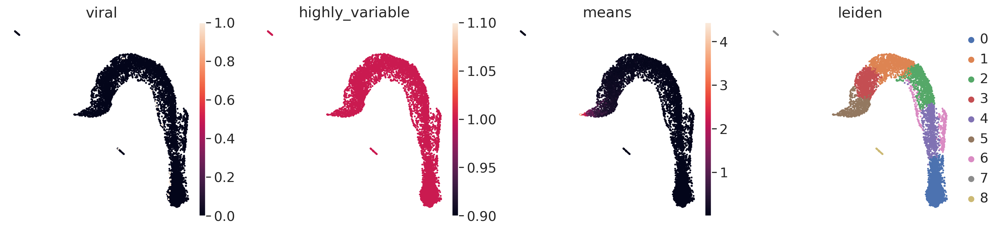

In [182]:
sc.pl.umap(mock_T, color=['viral', 'highly_variable', 'means', 'leiden'])

In [187]:
df = adata2[:, adata2.var.highly_variable].to_df().T
df['leiden'] = mock_T.obs.leiden.values

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [190]:
mock = mock_T.T.copy()

In [192]:
exp = df.groupby('leiden').mean().T
for col in exp.columns:
    mock.obs[col] = exp[[col]]

/home/icb/yuge.ji/miniconda3/envs/py37/lib/python3.7/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


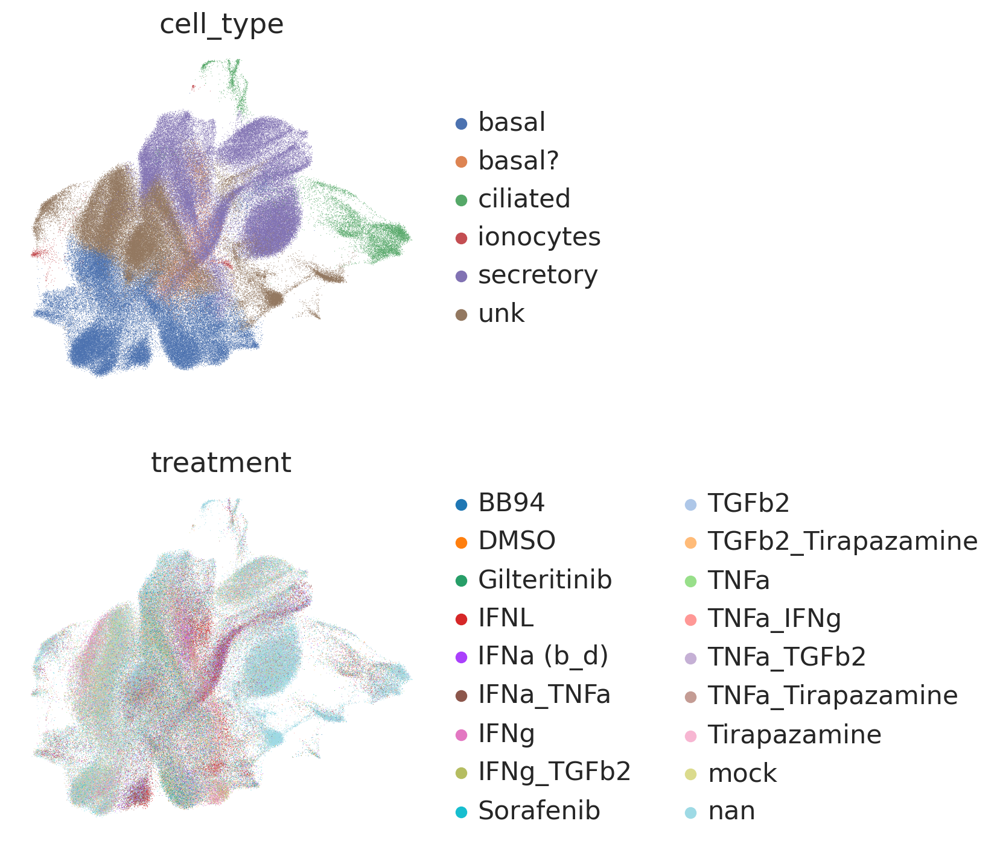

In [209]:
sc.pl.umap(adata2, color=['cell_type', 'treatment'], ncols=1)

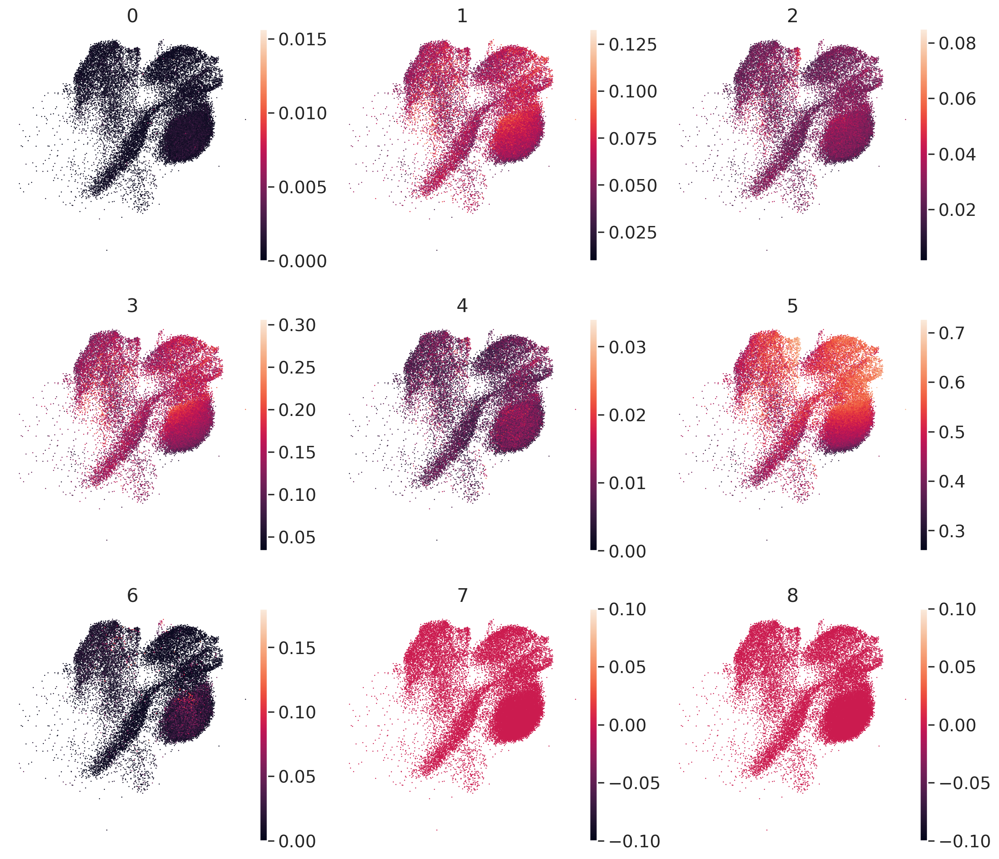

In [206]:
sc.pl.umap(mock, color=['0', '1', '2', '3', '4', '5', '6', '7', '8'], ncols=3)